# Imaging module tutorial

This tutorial shows how to explore the imaging parameters and perform a basic image quality check, convert DICOM into NRRD, check ROI segmentations, pre-process the images, and extract radiomic features.

Importing modules:

In [1]:
import os,sys
import sys
sys.path.append("../")  # Adds higher directory to python modules path.

from pmtool.ToolBox import ToolBox
import pandas as pd
from pandas import DataFrame
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sb

%matplotlib inline

## Data download

The Lung1 dataset (Aerts et al., 2014) contains pretreatment scans of 422 non-small cell lung cancer (NSCLC) patients, as well as manually deliniated gross tumor volume (GTV) for each patient, and clinical outcomes. More information you can find on the dataset web page and in the corresponding paper https://doi.org/10.1038/ncomms5006. For consistency, we recommend you to download the data to the '../data/dcms' folder of this project. You can find the data and its description (and the original paper) following the link below:
https://wiki.cancerimagingarchive.net/display/Public/NSCLC-Radiomics

To download the dataset, you might need to install the download manager: https://wiki.cancerimagingarchive.net/display/NBIA/Downloading+TCIA+Images#DownloadingTCIAImages-DownloadingtheNBIADataRetriever

Finally, you will have the '../data/dcms' folder with CT images (it will require 33 GB of disc space!).  

Alternatively, TCIA provides a Python interface. To know more, see these examples https://github.com/kirbyju/TCIA_Notebooks/blob/main/TCIA_REST_API_Downloads.ipynb and follow the instructions below:

In [2]:
# installation - comment these lines if you have TCIA client installed!

!pip install --upgrade -q tcia-utils --user
!pip install --upgrade -q pandas --user

# setup

from tcia_utils import nbia
import requests

We are interested in getting "NSCLC-Radiomics" collection:

In [3]:
# ds_metadata = nbia.getSeries(collection = "NSCLC-Radiomics")
# # having a look at the metadata
# print(ds_metadata)

# # downloading data for 3 patients, delete 'number = 3' to get all the data
# df = nbia.downloadSeries(ds_metadata, path ='../data/dcms/', format = "csv", number = 3)

2023-06-25 21:38:07,077:INFO:Calling... https://services.cancerimagingarchive.net/nbia-api/services/v1/getSeries with parameters {'Collection': 'NSCLC-Radiomics'}
2023-06-25 21:38:07,077:INFO:Calling... https://services.cancerimagingarchive.net/nbia-api/services/v1/getSeries with parameters {'Collection': 'NSCLC-Radiomics'}
2023-06-25 21:38:12,933:INFO:Downloading 3 out of 1265 Series Instance UIDs (scans).
2023-06-25 21:38:12,933:INFO:Downloading 3 out of 1265 Series Instance UIDs (scans).


[{'SeriesInstanceUID': '1.3.6.1.4.1.32722.99.99.320898527671900265039224224949289088459', 'StudyInstanceUID': '1.3.6.1.4.1.32722.99.99.292318530655723826015592519561359458189', 'Modality': 'CT', 'ProtocolName': 'MAASTRO_PETCT_WholeBodyC', 'SeriesDate': '2006-04-13 00:00:00.0', 'BodyPartExamined': 'LUNG', 'SeriesNumber': 0, 'Collection': 'NSCLC-Radiomics', 'PatientID': 'LUNG1-048', 'Manufacturer': 'SIEMENS', 'ManufacturerModelName': 'Sensation 16', 'SoftwareVersions': 'VA70C', 'ImageCount': 135, 'TimeStamp': '2020-10-07 14:01:08.0', 'LicenseName': 'Creative Commons Attribution-NonCommercial 3.0 Unported License', 'LicenseURI': 'https://creativecommons.org/licenses/by-nc/3.0/', 'CollectionURI': 'https://doi.org/10.7937/K9/TCIA.2015.PF0M9REI', 'FileSize': 71041260}, {'SeriesInstanceUID': '1.3.6.1.4.1.32722.99.99.71621653125201582124240564508842688465', 'StudyInstanceUID': '1.3.6.1.4.1.32722.99.99.100855571832074152951605738408734618579', 'Modality': 'CT', 'ProtocolName': 'MAASTRO_PETCT_Wh

2023-06-25 21:38:13,264:WARNING:Series 1.3.6.1.4.1.32722.99.99.320898527671900265039224224949289088459 already downloaded.


[{'SeriesInstanceUID': '1.3.6.1.4.1.32722.99.99.320898527671900265039224224949289088459', 'StudyInstanceUID': '1.3.6.1.4.1.32722.99.99.292318530655723826015592519561359458189', 'Modality': 'CT', 'ProtocolName': 'MAASTRO_PETCT_WholeBodyC', 'SeriesDate': '2006-04-13 00:00:00.0', 'BodyPartExamined': 'LUNG', 'SeriesNumber': 0, 'Collection': 'NSCLC-Radiomics', 'PatientID': 'LUNG1-048', 'Manufacturer': 'SIEMENS', 'ManufacturerModelName': 'Sensation 16', 'SoftwareVersions': 'VA70C', 'ImageCount': 135, 'TimeStamp': '2020-10-07 14:01:08.0', 'LicenseName': 'Creative Commons Attribution-NonCommercial 3.0 Unported License', 'LicenseURI': 'https://creativecommons.org/licenses/by-nc/3.0/', 'CollectionURI': 'https://doi.org/10.7937/K9/TCIA.2015.PF0M9REI', 'FileSize': 71041260}, {'SeriesInstanceUID': '1.3.6.1.4.1.32722.99.99.71621653125201582124240564508842688465', 'StudyInstanceUID': '1.3.6.1.4.1.32722.99.99.100855571832074152951605738408734618579', 'Modality': 'CT', 'ProtocolName': 'MAASTRO_PETCT_Wh

2023-06-25 21:38:13,580:WARNING:Series 1.3.6.1.4.1.32722.99.99.71621653125201582124240564508842688465 already downloaded.
2023-06-25 21:38:13,264:WARNING:Series 1.3.6.1.4.1.32722.99.99.320898527671900265039224224949289088459 already downloaded.
2023-06-25 21:38:13,580:WARNING:Series 1.3.6.1.4.1.32722.99.99.71621653125201582124240564508842688465 already downloaded.
2023-06-25 21:38:13,905:WARNING:Series 1.3.6.1.4.1.32722.99.99.138522260934437218114778023563031054616 already downloaded.
2023-06-25 21:38:13,905:WARNING:Series 1.3.6.1.4.1.32722.99.99.138522260934437218114778023563031054616 already downloaded.
2023-06-25 21:38:13,930:INFO:Downloading... https://services.cancerimagingarchive.net/nbia-api/services/v1/getImage?NewFileNames=Yes&SeriesInstanceUID=1.3.6.1.4.1.32722.99.99.134645872977266948002680323417926540760
2023-06-25 21:38:13,930:INFO:Downloading... https://services.cancerimagingarchive.net/nbia-api/services/v1/getImage?NewFileNames=Yes&SeriesInstanceUID=1.3.6.1.4.1.32722.99.

CSV file will be found in the notebook directory and it should go to '../data/features' folder.

## Dataset exploration

This functionality aims to retreive meta-information from the DICOM headers in order to explore the imaging parameters presented in the dataset.

Setting the parameters:

In [4]:
parameters = {'data_path': r'../data/dcms/', # path to your DICOM data
              'data_type': 'dcm', # original data format: DICOM
              'multi_rts_per_pat': False}   # when False, it will look only for 1 rtstruct in the patient folder, 
                                            # this will speed up the process, 
                                            # if you have more then 1 rtstruct per patient, set it to True


Initialize the dataset:

In [5]:
data_dcms = ToolBox(**parameters)

100%|█████████████████████████████████████████████| 9/9 [00:02<00:00,  3.09it/s]



Get the default metainformation from the DICOM files and print first 10:

In [6]:
dataset_description = data_dcms.get_dataset_description() 
dataset_description.head(10)

Patients processed: 100%|█████████████████████████| 3/3 [00:02<00:00,  1.29it/s]



,Modality,SliceThickness,PixelSpacing,SeriesDate,Manufacturer,patient,slice#
0,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,0
1,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,1
2,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,2
3,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,3
4,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,4
5,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,5
6,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,6
7,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,7
8,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,8
9,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,9


,Modality,SliceThickness,PixelSpacing,SeriesDate,Manufacturer,patient,slice#
0,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,0
1,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,1
2,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,2
3,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,3
4,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,4
5,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,5
6,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,6
7,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,7
8,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,8
9,CT,3.0,"[0.9770, 0.9770]",NaN,"CMS, Inc.",LUNG1-003_20180209_CT_1,9


You can check for the needed info by printing unique values of the tags:

In [7]:
print('Unique modalities found: ', np.unique(dataset_description.Modality.values)[0])

Unique modalities found:  CT
Unique modalities found:  CT


There are two pre-set parameter dictionaries for 'CT' and 'MRI' with the extended amount of parameters, parsed from the DICOM tags. These parameters are specific for these imaging modalities. You can also send a custom list of parameters. In this case the DICOM tags should have the same names as corresponding pydicom (DICOM keyword, https://pydicom.github.io/pydicom/dev/old/base_element.html).

Get the CT-specific metainformation from the DICOM files and print first 10:

In [8]:
ct_dcms = ToolBox(**parameters)
dataset_description = ct_dcms.get_dataset_description('CT') 
dataset_description.head(10)

100%|█████████████████████████████████████████████| 9/9 [00:03<00:00,  2.69it/s]

Patients processed: 100%|█████████████████████████| 3/3 [00:02<00:00,  1.21it/s]



,PatientName,ConvolutionKernel,SliceThickness,PixelSpacing,KVP,Exposure,XRayTubeCurrent,SeriesDate,patient,slice#
0,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,0
1,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,1
2,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,2
3,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,3
4,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,4
5,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,5
6,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,6
7,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,7
8,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,8
9,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,9


,PatientName,ConvolutionKernel,SliceThickness,PixelSpacing,KVP,Exposure,XRayTubeCurrent,SeriesDate,patient,slice#
0,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,0
1,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,1
2,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,2
3,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,3
4,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,4
5,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,5
6,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,6
7,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,7
8,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,8
9,"(L, U, N, G, 1, -, 0, 0, 3)",NaN,3.0,"[0.9770, 0.9770]",NaN,NaN,NaN,NaN,LUNG1-003_20180209_CT_1,9


Let's plot some of the scans parameters:

2023-06-25 21:39:07,157:INFO:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-06-25 21:39:07,157:INFO:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-06-25 21:39:07,159:INFO:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-06-25 21:39:07,159:INFO:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-06-25 21:39:07,213:INFO:Using categorical units to plot a list of strings that are all parsable as floats or dates. If 

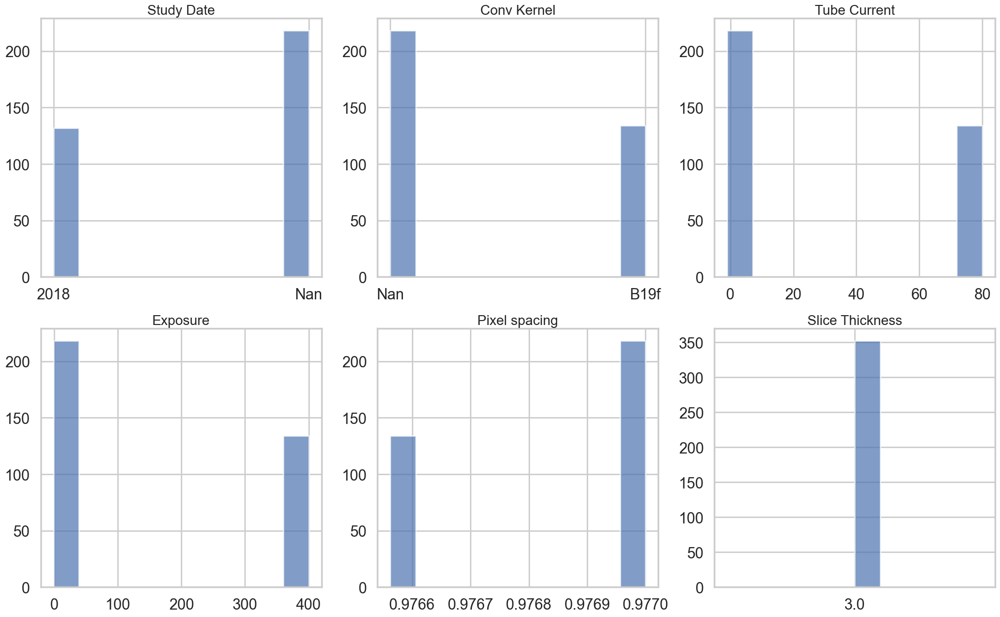

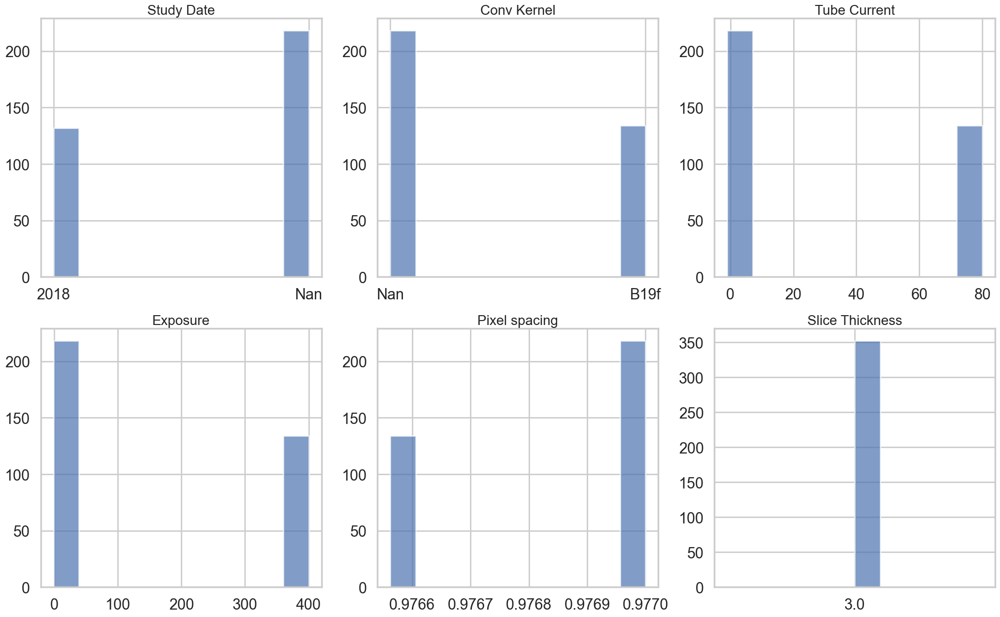

In [9]:
sb.set(context='poster', style='whitegrid')

study_date = sorted([ 'Nan' if x=='' or x=='NaN' else str(x[0:4]) for x in list(dataset_description['SeriesDate'])])[2:]
conv_kernel =['Nan' if x=='' or x=='NaN' else x for x in list(dataset_description['ConvolutionKernel'])]
tube_current =[-1 if x=='' or x=='NaN' else x for x in list(dataset_description['XRayTubeCurrent'])]
exposure =[-1 if x=='' or x=='NaN' else x for x in list(dataset_description['Exposure'])]
ps = sorted([(x[0]) for x in list(filter(lambda x: x != 'NaN', dataset_description['PixelSpacing'].values))])
sl_th = sorted([str(x)[0:3] for x in list(filter(lambda x: x != 'NaN', dataset_description['SliceThickness'].values))])
figures,descriptions = [study_date,conv_kernel,tube_current,exposure,ps,sl_th],['Study Date','Conv Kernel','Tube Current','Exposure','Pixel spacing','Slice Thickness']

fig,ax = plt.subplots(2,3,figsize=(25,15))
for i in range(2):
    for j in range(3):
        ax[i,j].hist(figures.pop(0),alpha=0.7)
        ax[i,j].set_title(descriptions.pop(0),fontsize=20)

## Quality control step

This functionality aims to perform a simple quality check of the data and possibly to detect the wrong scans. These might be scans: of wrong imaging modality, with wrong imaging projections, with non-consistent (missing/overlapping) slices, with unsufficient amount of slices, with slice thickness inconsistent or out of the defined range, with pixel spacing out of range, with unknown or unacceptable konvolution kernel, with wrong axial plane resolution, with missing slope/intercept tags. To perform this check, the target scanning parameters are to be passed to the function. By removing/commenting some of the input parameters, the corresponding checks are disabled. For each patient, the output table contains the following flags: '1' - check passed, '0' - check failed.

In [10]:
qc_params = {'specific_modality': 'ct', # target modality: CT
            'thickness_range': [2,5], # slice thickness should be in range of 2..5 mm
            'spacing_range': [0.5,1.25], # pixel spacing should be in range of 0.5..1.25 mm
            'scan_length_range': [5,170], # scan should contain from 5 to 170 slices
            'axial_res': [512,512], # the axial resolution should be 512x512
            'kernels_list': ['standard','lung','b19f']} # the following kernels are acceptable

In [11]:
qc_dataframe = ct_dcms.get_quality_checks(qc_params)

 33%|███████████████                              | 1/3 [00:00<00:01,  1.20it/s]

Cannot perform conv kernel check for pat: LUNG1-003_20180209_CT_1
Cannot perform conv kernel check for pat: LUNG1-003_20180209_CT_1


100%|█████████████████████████████████████████████| 3/3 [00:02<00:00,  1.24it/s]

Cannot perform conv kernel check for pat: LUNG1-002_20180526_CT_1
Cannot perform conv kernel check for pat: LUNG1-002_20180526_CT_1


In [12]:
qc_dataframe

,Patient id,Modality is acceptable,Projection is axial,Complete scan (no missing/overlapping slices),Scan len is in range,Slice thickness is in range,Slice thickness is consistent,Pixel spacing is in range,Convolutional kernel tag is present,Convolutional kernel is acceptable,Axial pr. resolution is acceptable,Intensity intercept/slope tags are present
0,LUNG1-003_20180209_CT_1,1,1,1,1,1,1,1,0,NaN,1,1
1,LUNG1-001_20180209_CT_2,1,1,1,1,1,1,1,1,1,1,1
2,LUNG1-002_20180526_CT_1,1,1,1,1,1,1,1,0,NaN,1,1


,Patient id,Modality is acceptable,Projection is axial,Complete scan (no missing/overlapping slices),Scan len is in range,Slice thickness is in range,Slice thickness is consistent,Pixel spacing is in range,Convolutional kernel tag is present,Convolutional kernel is acceptable,Axial pr. resolution is acceptable,Intensity intercept/slope tags are present
0,LUNG1-003_20180209_CT_1,1,1,1,1,1,1,1,0,NaN,1,1
1,LUNG1-001_20180209_CT_2,1,1,1,1,1,1,1,1,1,1,1
2,LUNG1-002_20180526_CT_1,1,1,1,1,1,1,1,0,NaN,1,1


##  DICOM to NRRD conversion

To convert DICOM dataset to the volume (nrrd) format, set up the parameters:  

* '*export_path = ...*' export path where the converted NRRDs will be placed,  
* '*region_of_interest = ...*' if you know exact name of the ROI you want to extract, then write it with the '!' character in front, eg. '*region_of_interest = !gtv1*',
* if you want to extract all the GTVs in the rtstruct eg. '*gtv1*', '*gtv2*', '*gtv_whatever*', then just specify the stem word, eg. '*region_of_interest = gtv*', 
* default value is '*region_of_interest ='all'*', where all ROI's in rtstruct will be extracted.

In [13]:
export_path =r'../data/' # the function will create 'converted_nrrd' folder in the specified directory

Initialize the dataset (originally downloaded directory with DICOM files):

In [14]:
data_ct = ToolBox(**parameters) 

100%|█████████████████████████████████████████████| 9/9 [00:02<00:00,  3.05it/s]



Run the conversion:

In [15]:
data_ct.convert_to_nrrd(export_path, 'gtv')

Patients converted: 100%|█████████████████████████| 3/3 [00:08<00:00,  2.80s/it]



## Quick check of the ROI's in the NRRD dataset

If you want to check your converted images & ROIs, or just any volumetric dataset (NRRD/MHA), you can use get_jpegs function of the toolbox. It will generate JPEG images for each slice with the image and overlap of the contour.

Initialize the dataset (converted NRRD files):

In [16]:
data_ct_nrrd = ToolBox(data_path = r'../data/converted_nrrds/', data_type='nrrd')

100%|████████████████████████████████████████████| 3/3 [00:00<00:00, 807.74it/s]



Run the visualization:

In [17]:
data_ct_nrrd.get_jpegs(r'../data/') # the function will create 'images_quick_check' folder in the specified directory 

Patients processed: 100%|█████████████████████████| 5/5 [01:13<00:00, 14.65s/it]



Let's check one of the patients:

LUNG1-003_20180209_CT_1_GTV-1_mask
LUNG1-003_20180209_CT_1_GTV-1_mask


interactive(children=(IntSlider(value=8, description='i', max=16), Output()), _dom_classes=('widget-interact',…

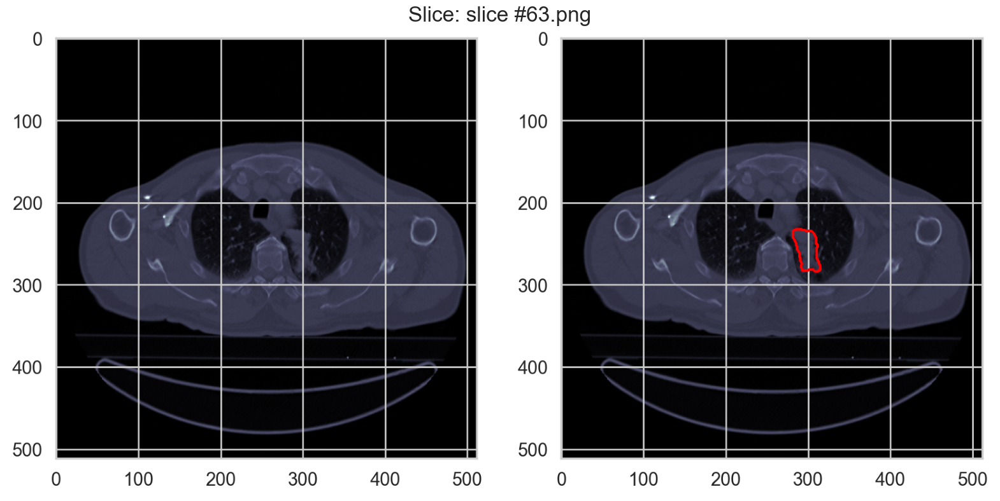

interactive(children=(IntSlider(value=8, description='i', max=16), Output()), _dom_classes=('widget-interact',…

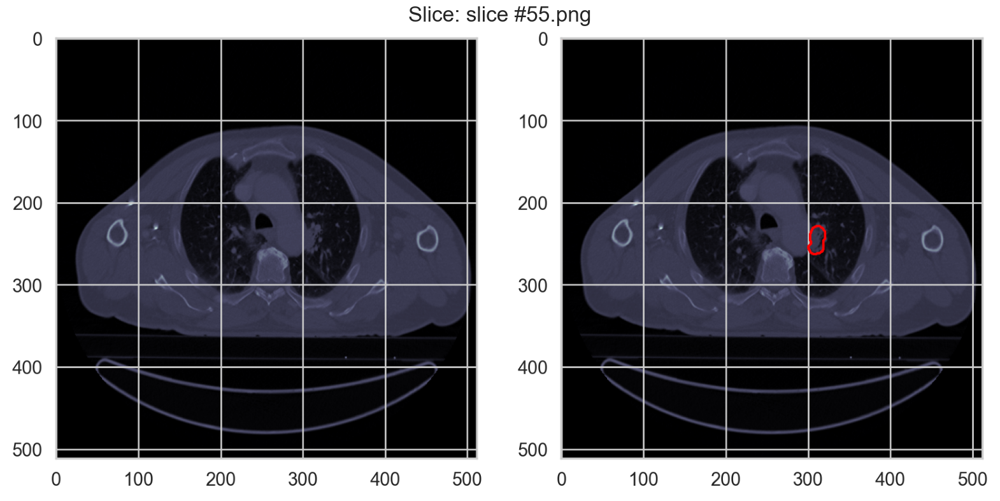

In [26]:
from ipywidgets import interact
import numpy as np
from PIL import Image

def browse_images(images,names):
    n = len(images)
    def view_image(i):
        plt.figure(figsize=(20,10))
        plt.imshow(images[i])#, cmap=plt.cm.gray_r, interpolation='nearest')
        plt.title('Slice: %s' % names[i])
        plt.axis('off')
        plt.show()
    interact(view_image, i=(0,n-1))
    
for pat,_ in data_ct_nrrd:
    _,file_struct = [*os.walk(os.path.join('../data/images_quick_check/',pat))]
    root,images = file_struct[0],file_struct[2]
    imgs =[np.array(Image.open(os.path.join(root,img))) for img in images]
    print(pat)
    browse_images(imgs,images)
    break

## Image pre-processing

Initialize the dataset (converted NRRD files):

In [19]:
data_ct_nrrd = ToolBox(data_path = r'../data/converted_nrrds/',
                    data_type='nrrd')

100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2770.35it/s]


  0%|                                                     | 0/5 [00:00<?, ?it/s]

----------------------------------------
Original image stats:
Number of unique intensity values : 3019
Intensity values range:[-1024:3071]
Image intensity dtype: int16
----------------------------------------
----------------------------------------
Original image stats:
Number of unique intensity values : 3019
Intensity values range:[-1024:3071]
Image intensity dtype: int16
----------------------------------------


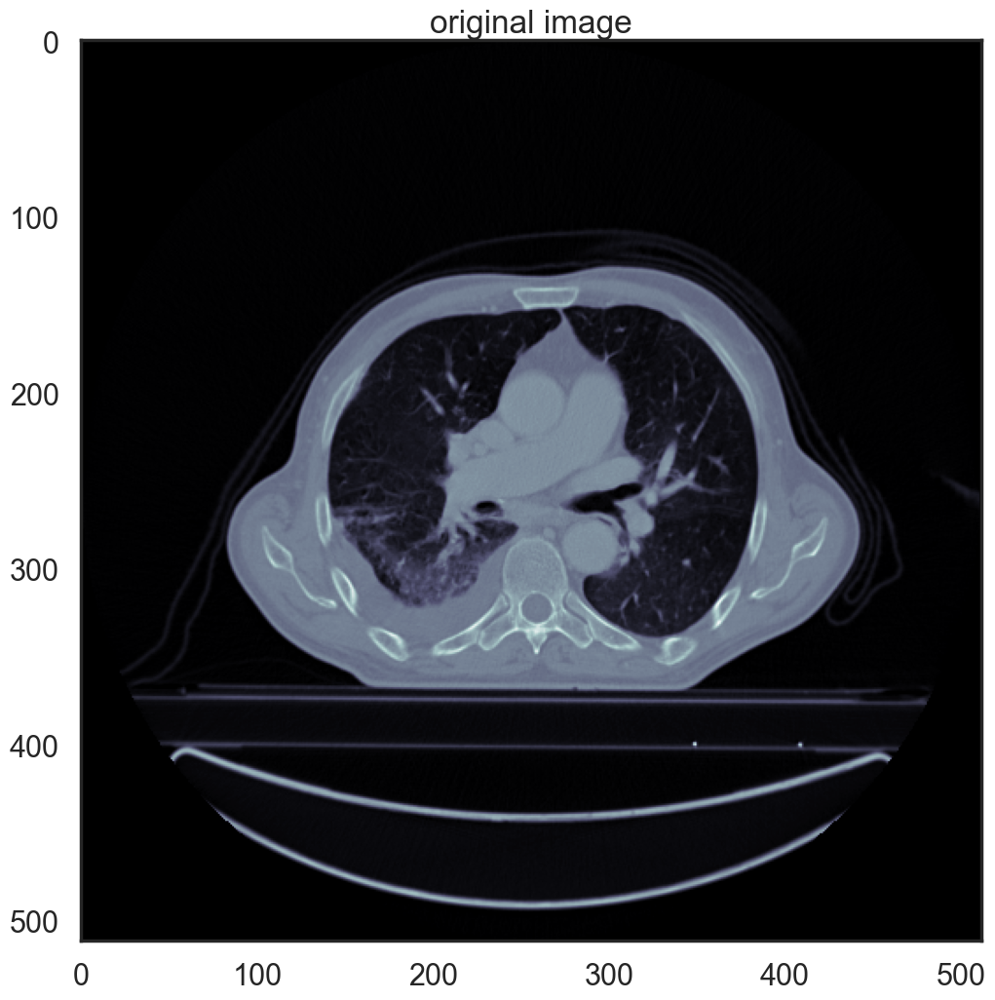

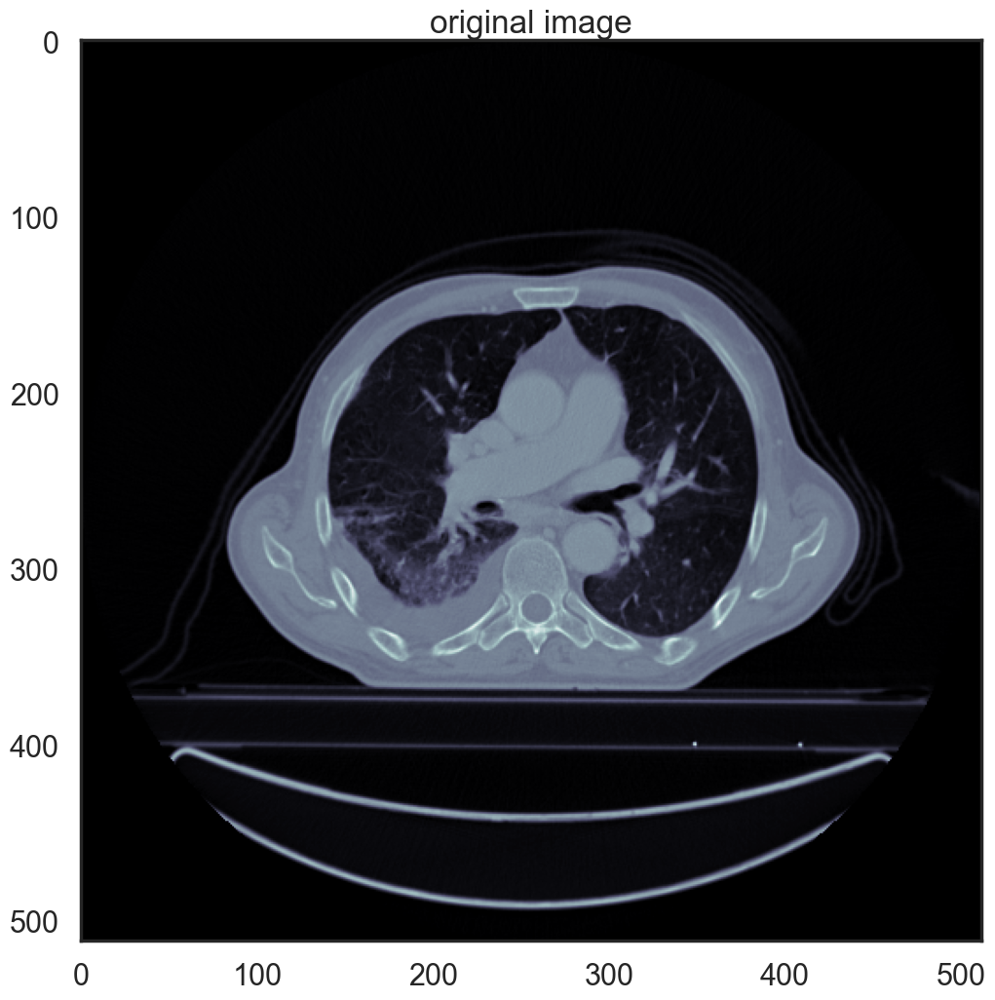

Window limits  -1000 150.0
Window limits  -1000 150.0
Window filtering applied
Window filtering applied


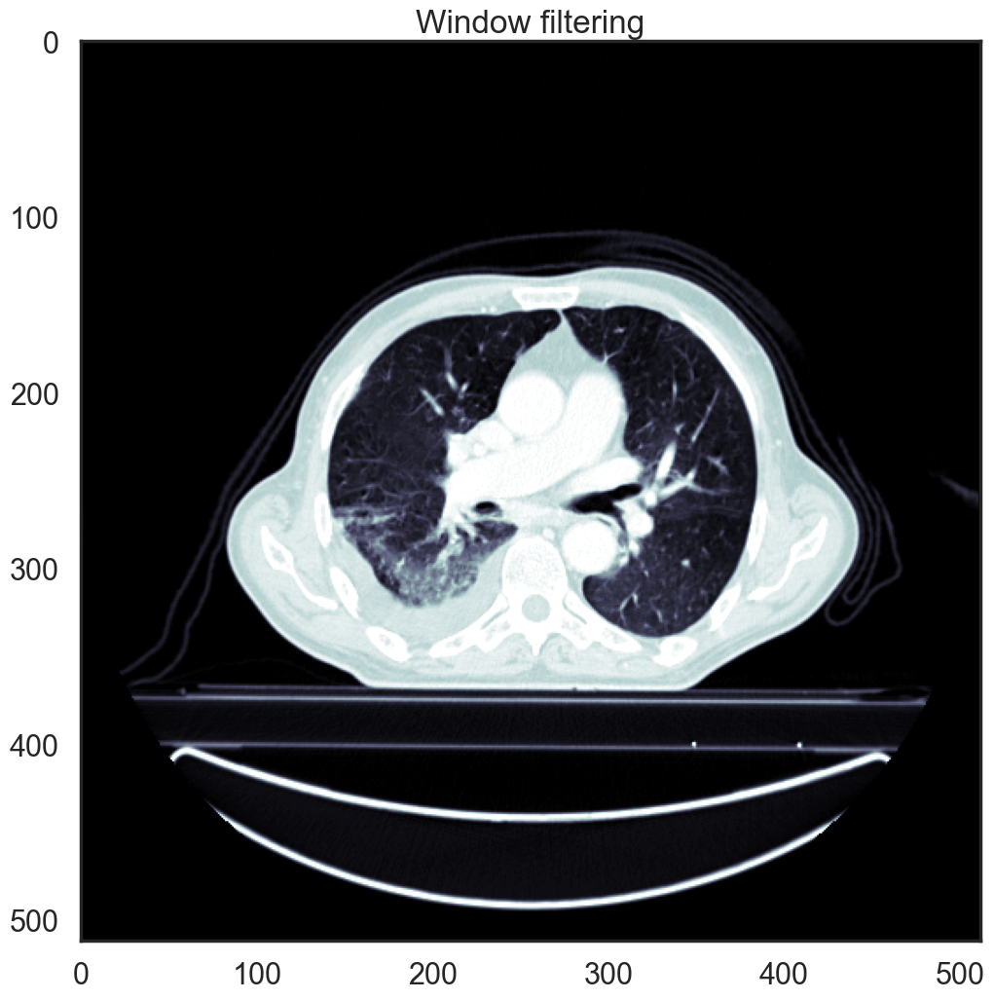

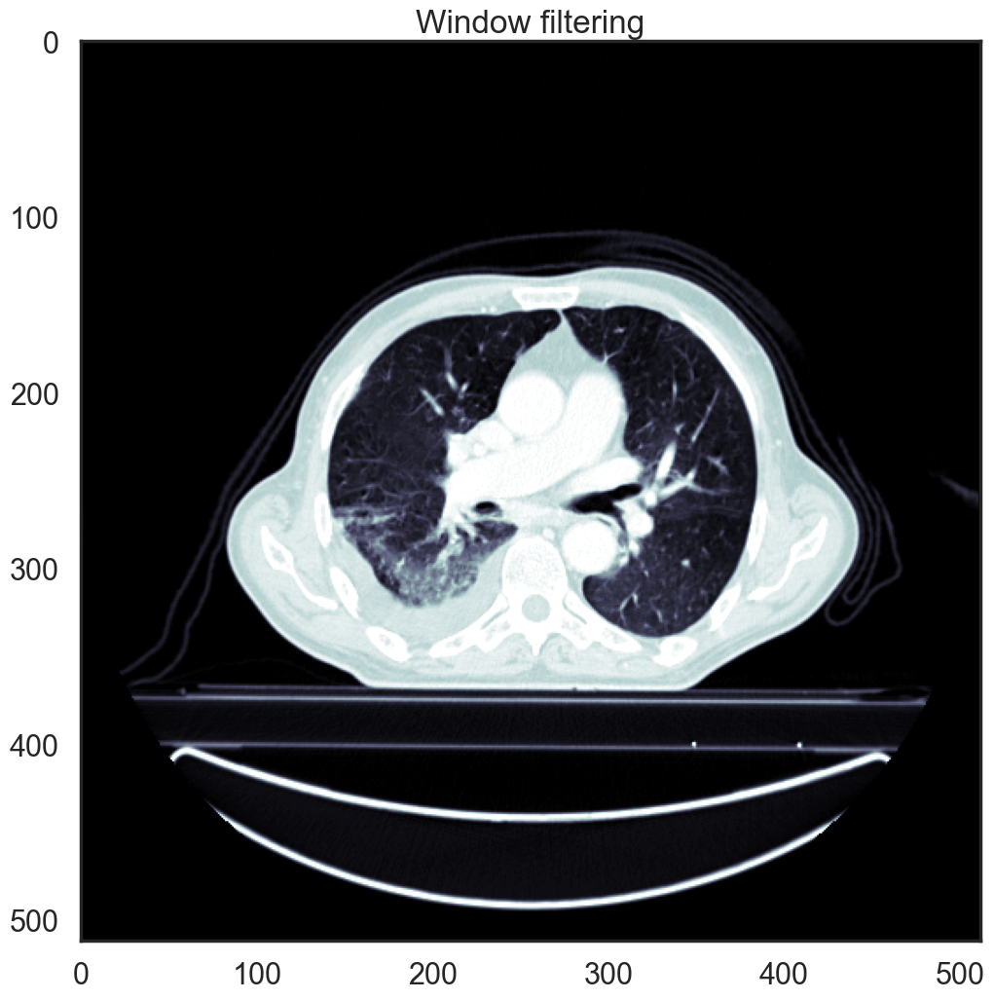

min:  0 max:  1150 step:  4.509803921568627
min:  0 max:  1150 step:  4.509803921568627
Resampling with a step of:  4.509803921568627 Amount of unique values, original img:  1151 resampled img:  255
Resampling with a step of:  4.509803921568627 Amount of unique values, original img:  1151 resampled img:  255
----------------------------------------
Intensity values resampled with a number of bins: 255
----------------------------------------
----------------------------------------
Intensity values resampled with a number of bins: 255
----------------------------------------


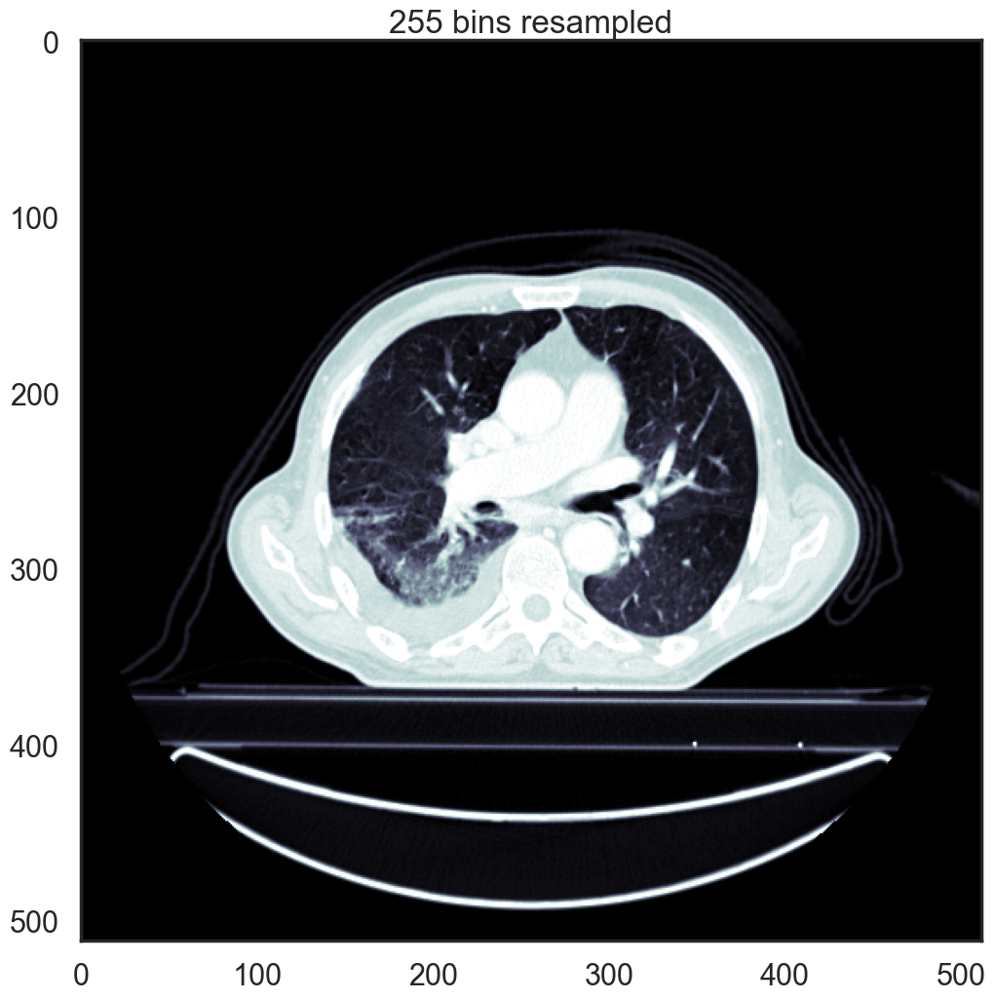

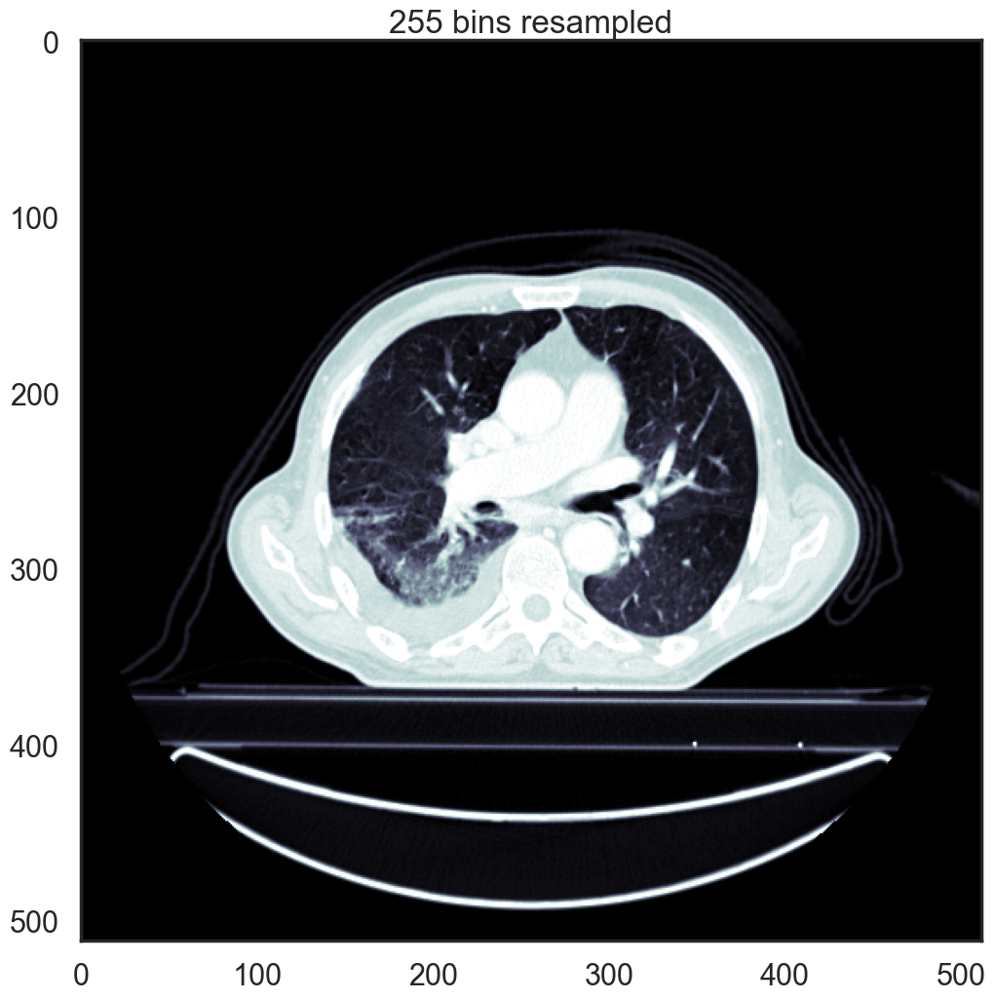

Z-score normalization applied based on the whole image, Mu=1000.0, sigma=500.0
Z-score normalization applied based on the whole image, Mu=1000.0, sigma=500.0


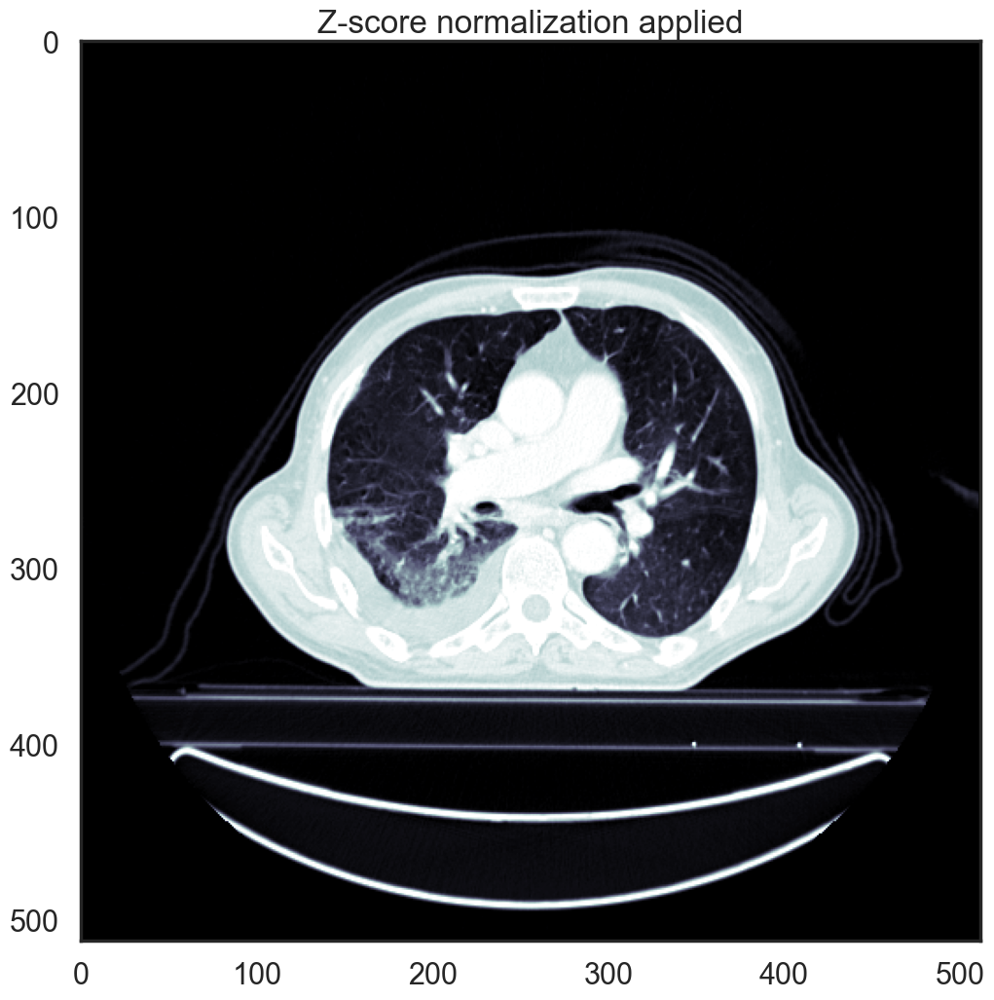

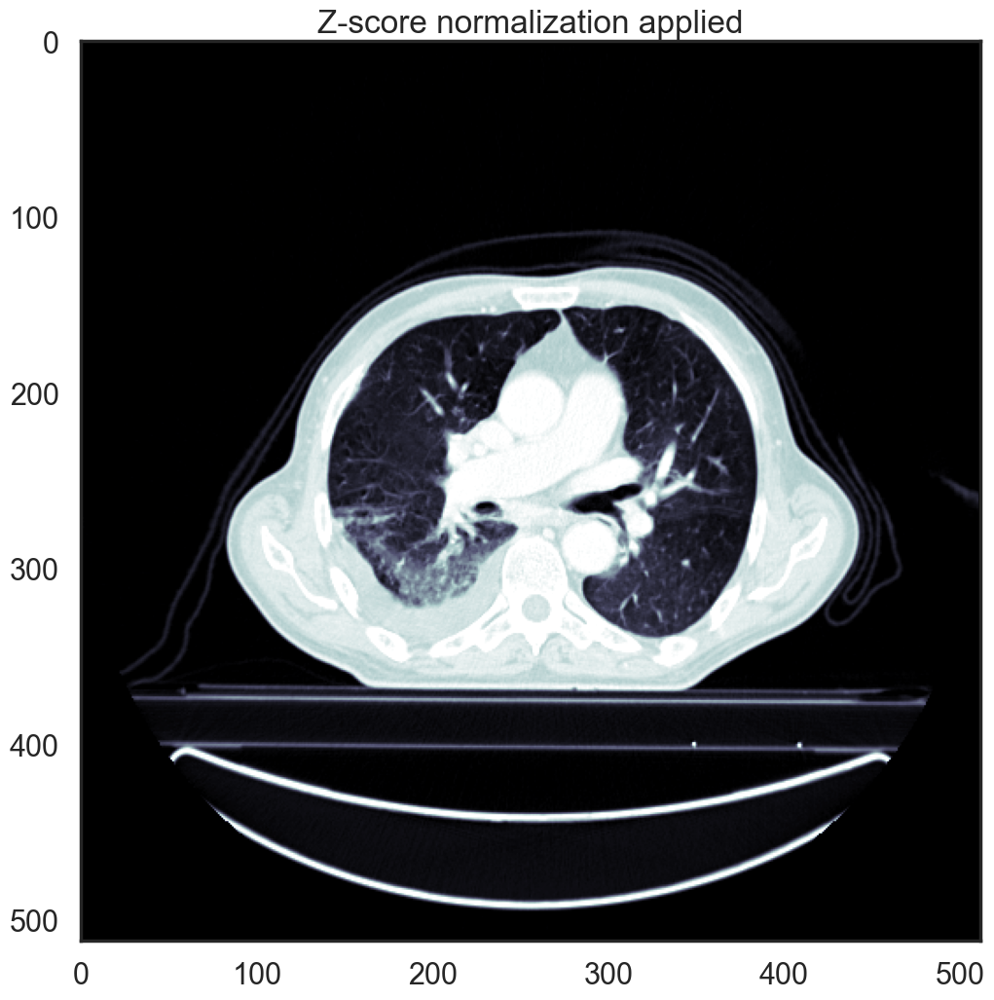

 20%|█████████                                    | 1/5 [00:23<01:34, 23.57s/it]

----------------------------------------
Original image stats:
Number of unique intensity values : 3033
Intensity values range:[-1024:3034]
Image intensity dtype: int16
----------------------------------------
----------------------------------------
Original image stats:
Number of unique intensity values : 3033
Intensity values range:[-1024:3034]
Image intensity dtype: int16
----------------------------------------


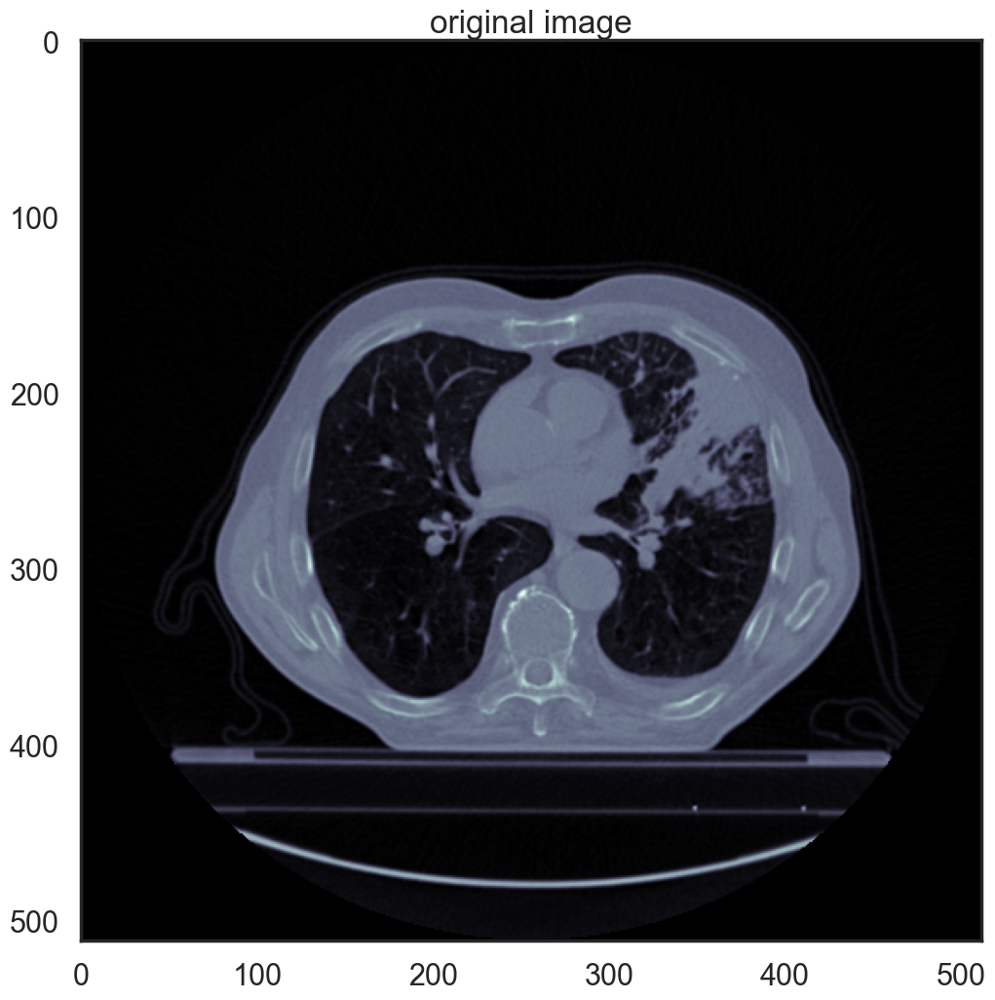

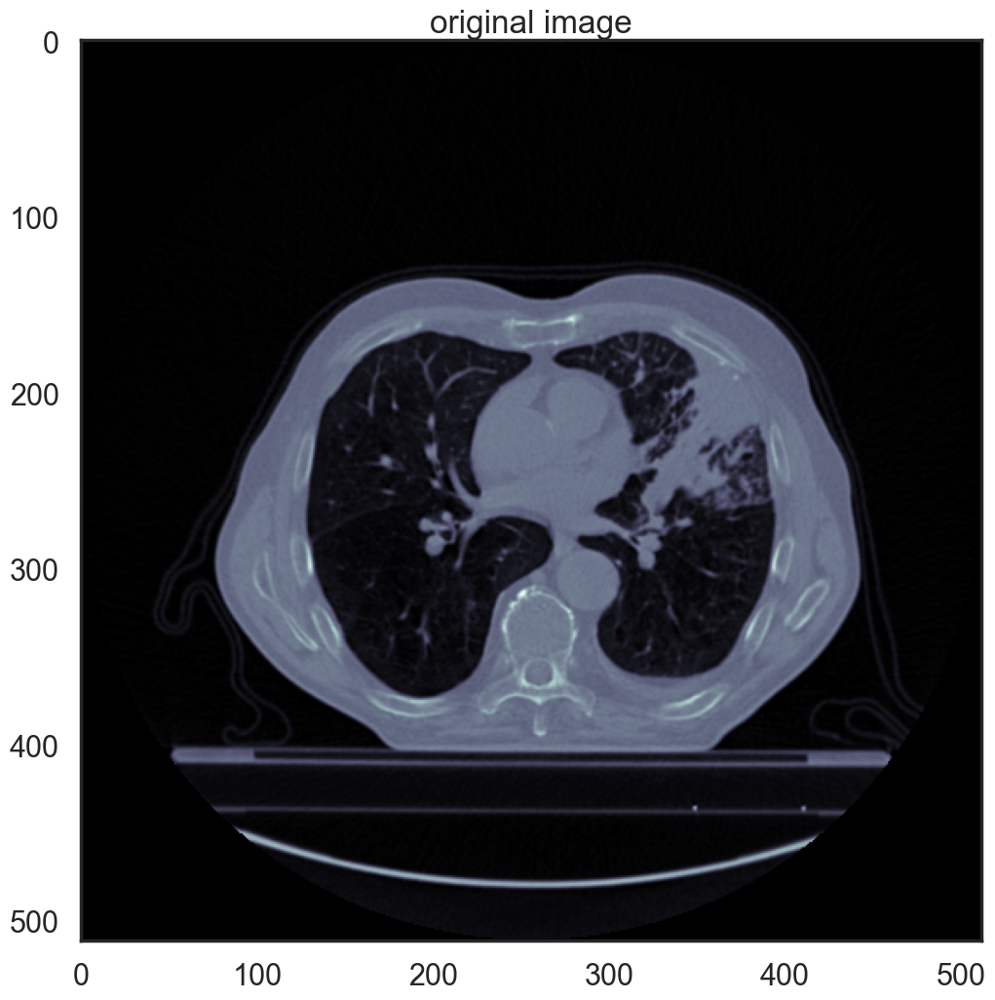

Window limits  -1000 150.0
Window limits  -1000 150.0
Window filtering applied
Window filtering applied


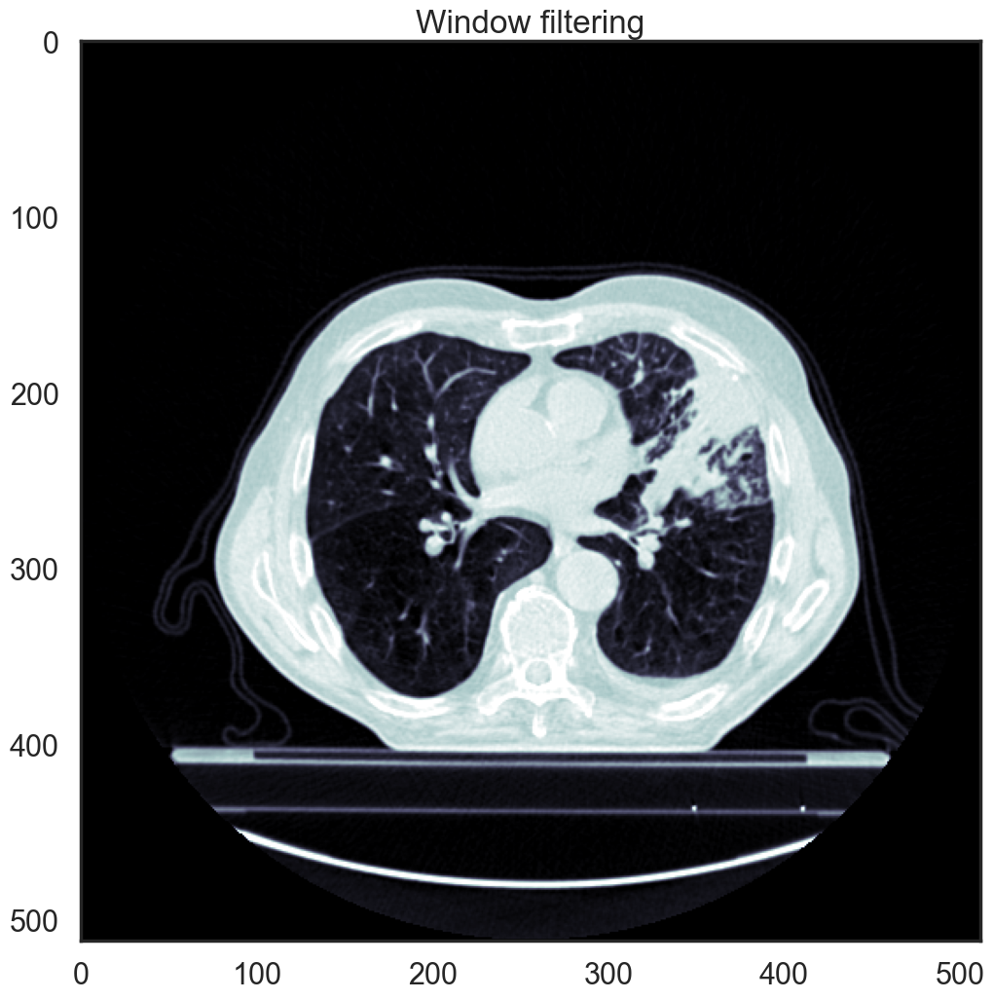

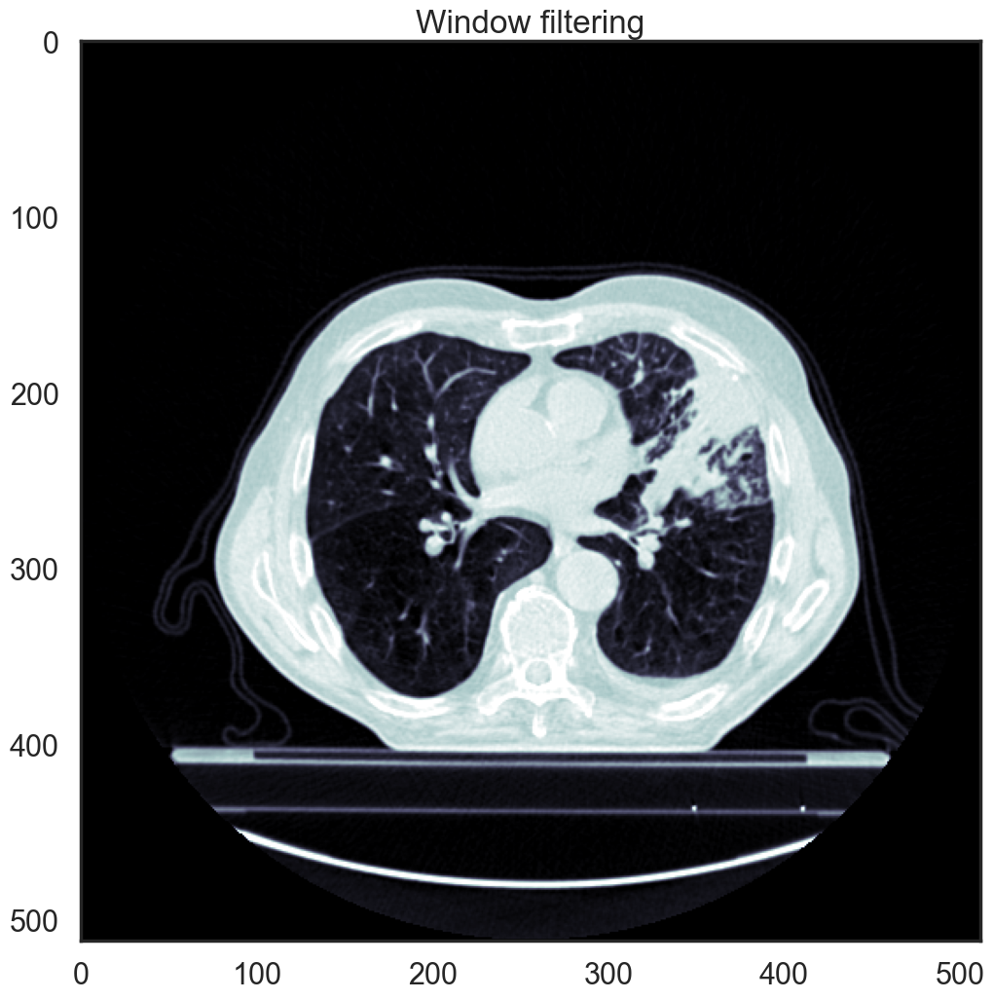

min:  0 max:  1150 step:  4.509803921568627
min:  0 max:  1150 step:  4.509803921568627
Resampling with a step of:  4.509803921568627 Amount of unique values, original img:  1151 resampled img:  255
Resampling with a step of:  4.509803921568627 Amount of unique values, original img:  1151 resampled img:  255
----------------------------------------
Intensity values resampled with a number of bins: 255
----------------------------------------
----------------------------------------
Intensity values resampled with a number of bins: 255
----------------------------------------


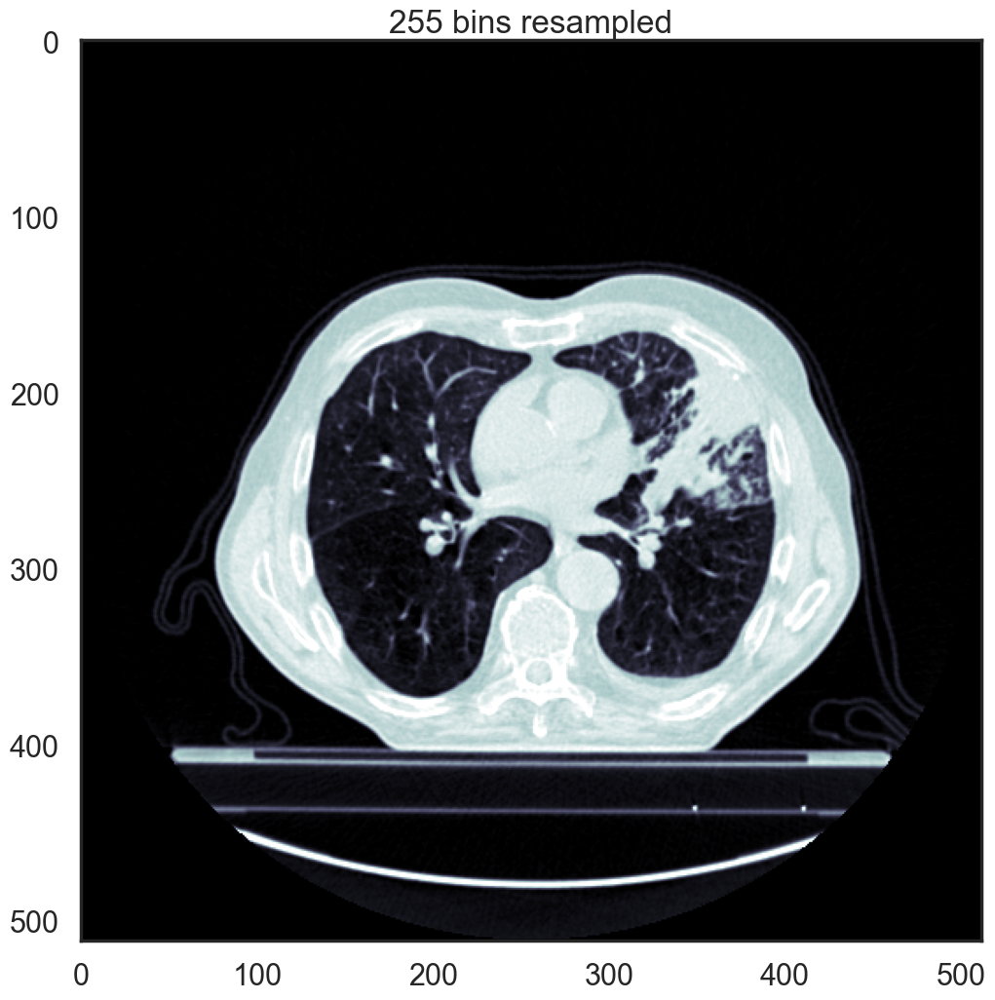

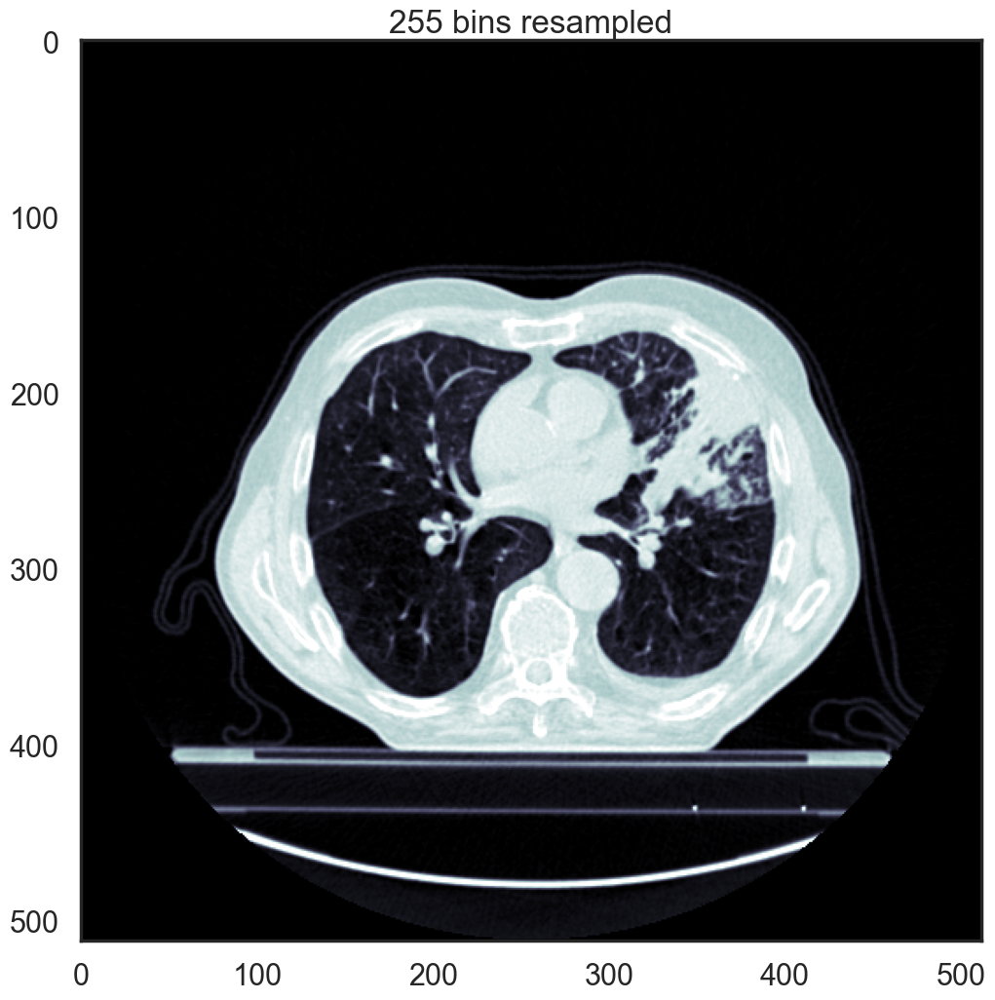

Z-score normalization applied based on the whole image, Mu=1000.0, sigma=500.0
Z-score normalization applied based on the whole image, Mu=1000.0, sigma=500.0


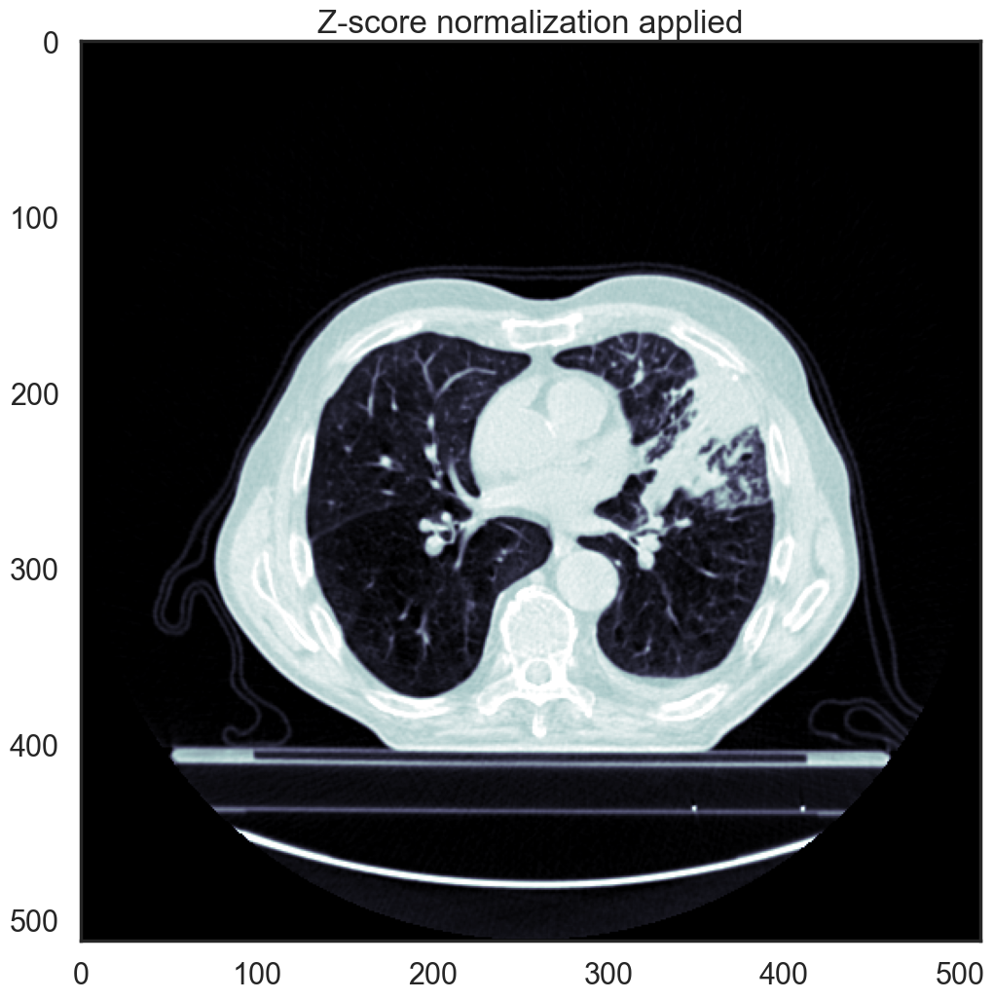

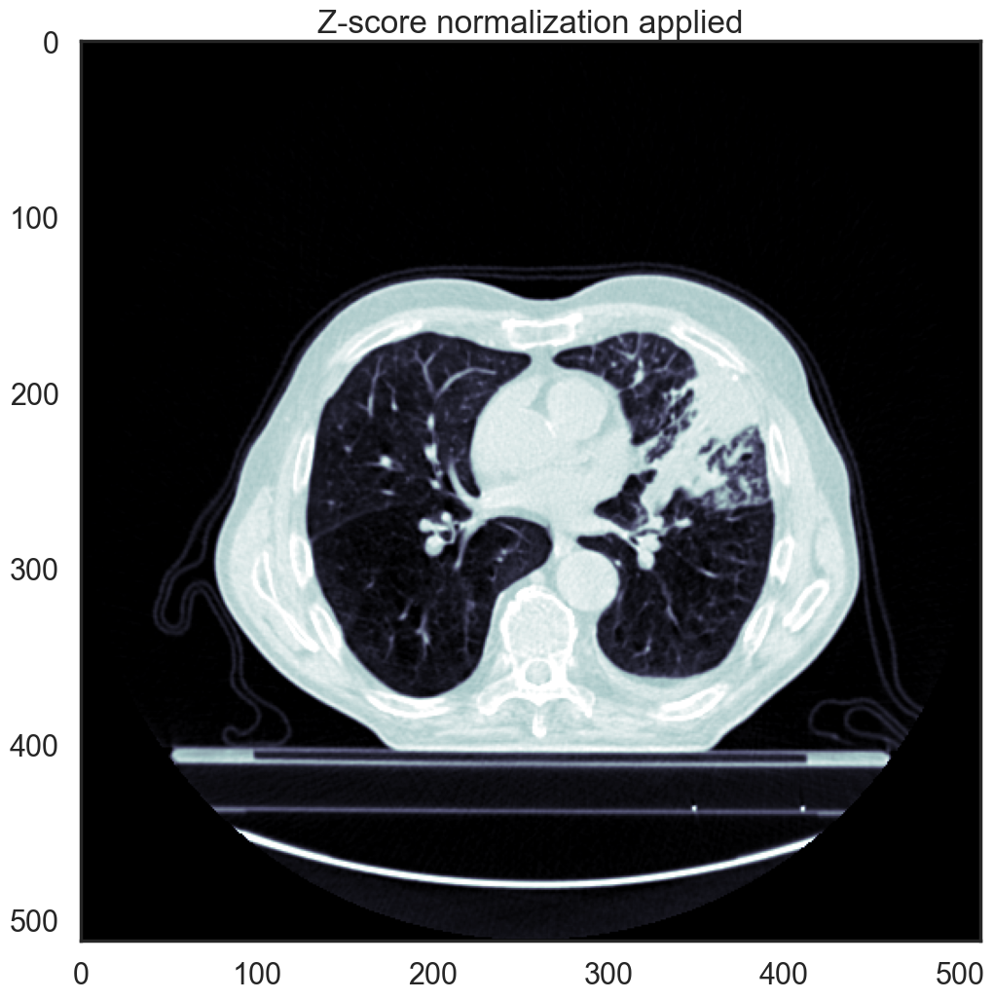

 40%|██████████████████                           | 2/5 [00:53<01:22, 27.34s/it]

----------------------------------------
Original image stats:
Number of unique intensity values : 3829
Intensity values range:[-1024:3071]
Image intensity dtype: int16
----------------------------------------
----------------------------------------
Original image stats:
Number of unique intensity values : 3829
Intensity values range:[-1024:3071]
Image intensity dtype: int16
----------------------------------------


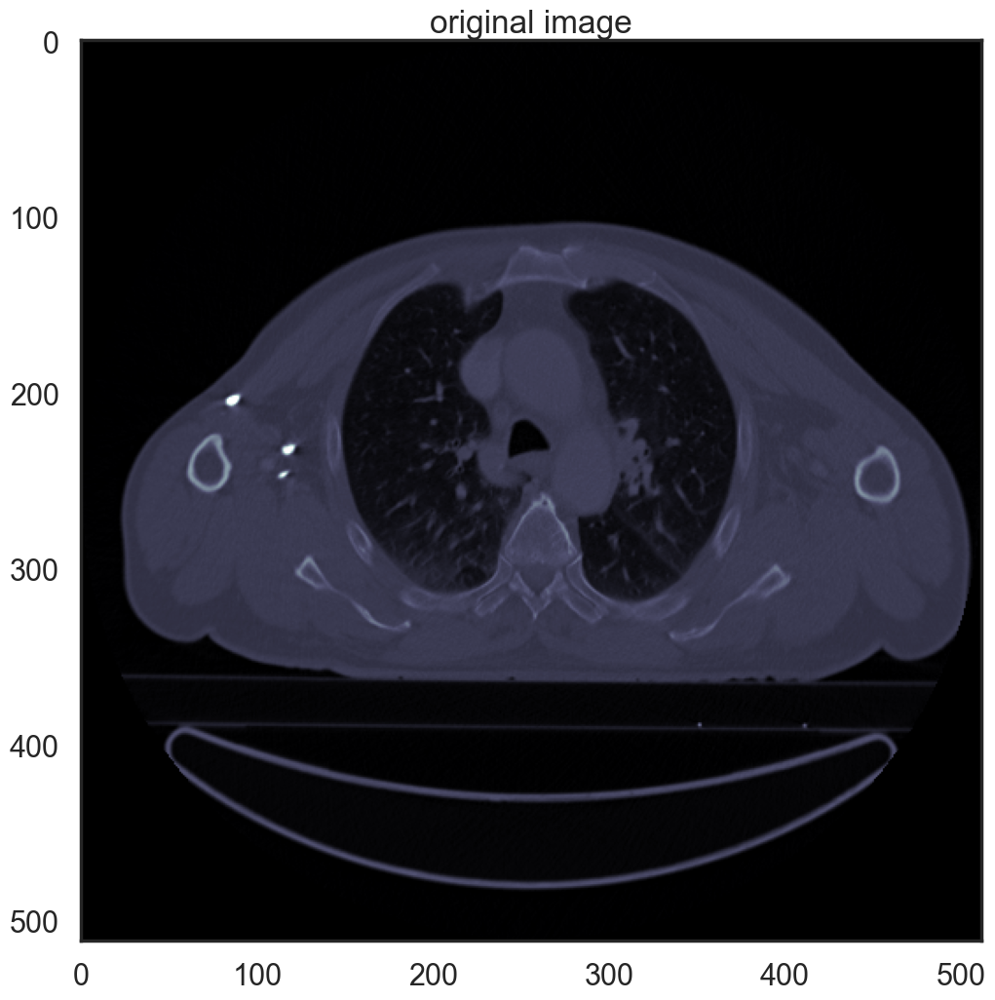

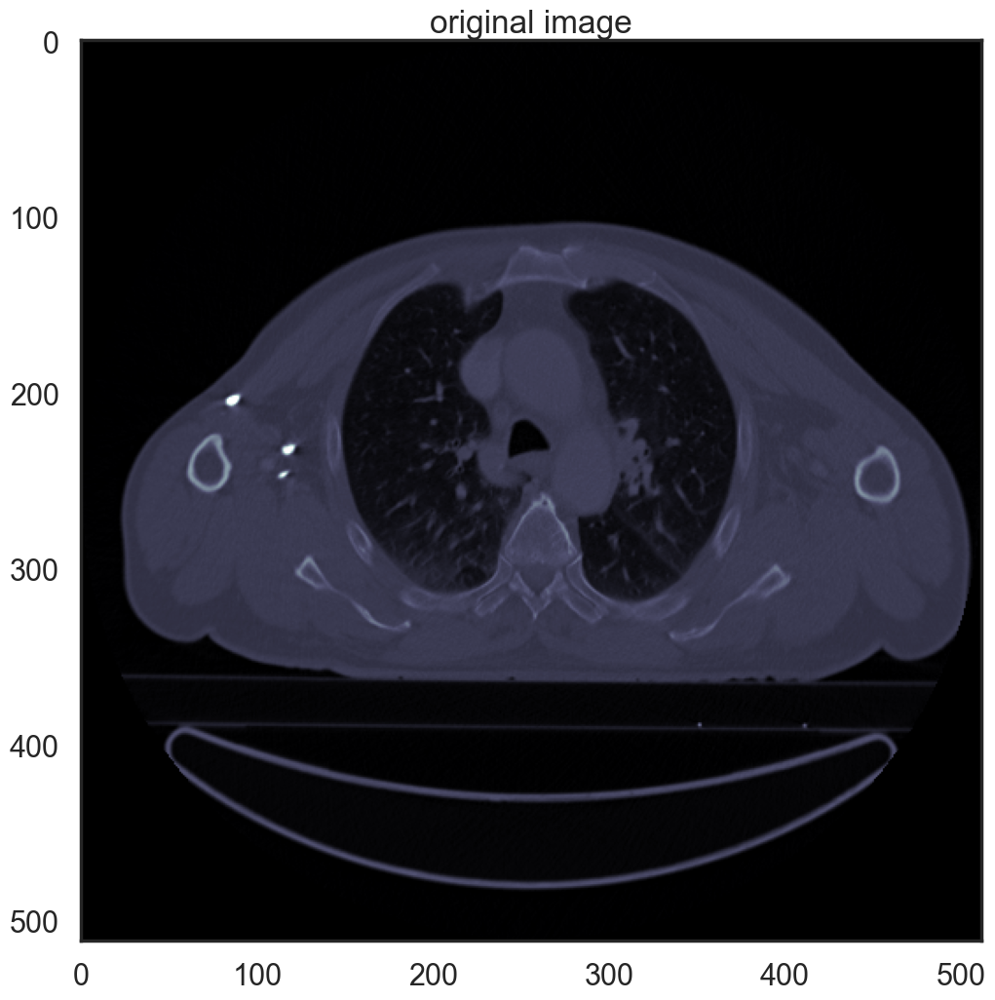

Window limits  -1000 150.0
Window limits  -1000 150.0
Window filtering applied
Window filtering applied


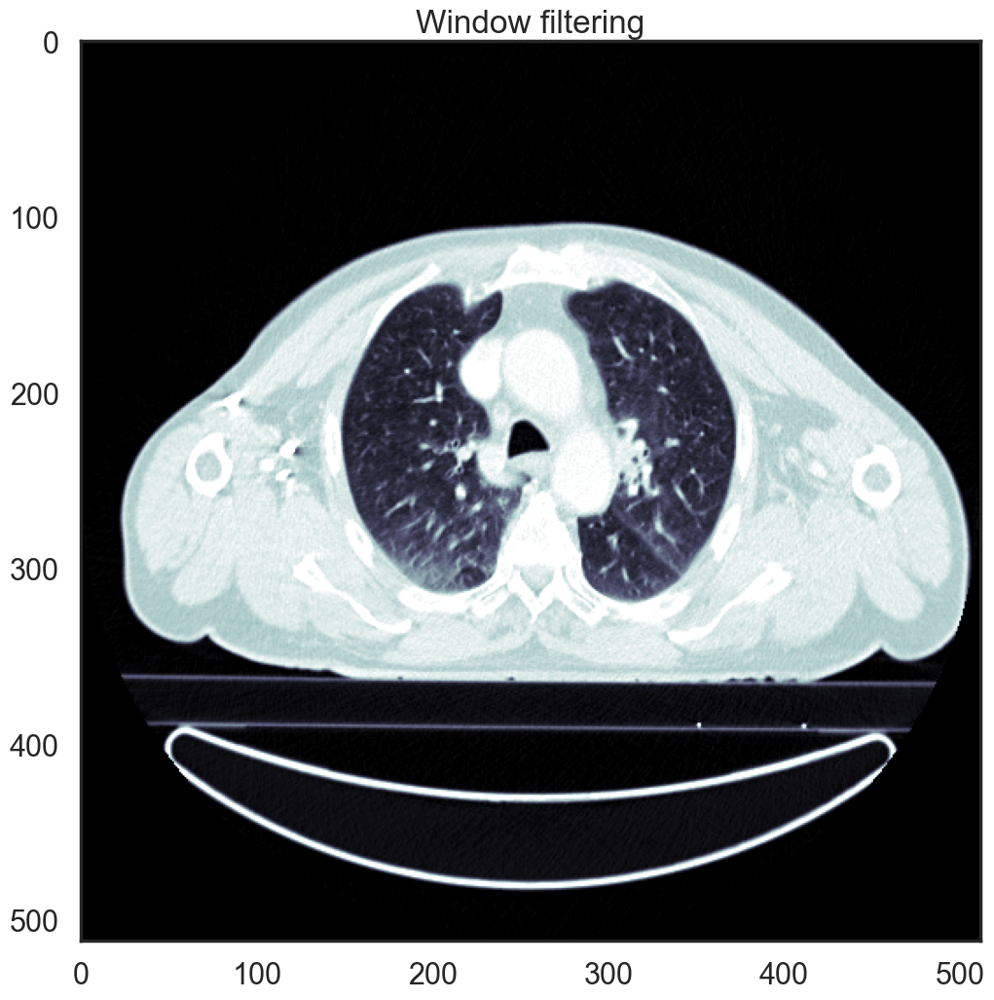

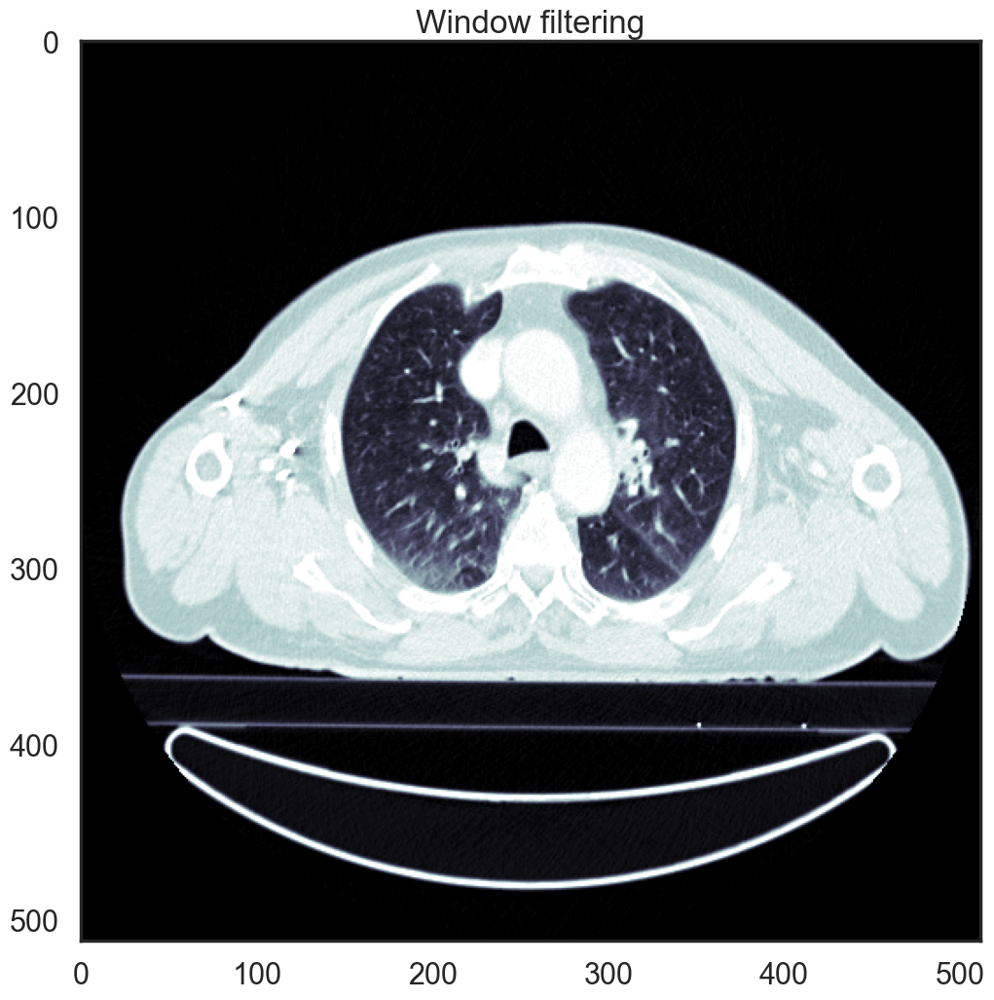

min:  0 max:  1150 step:  4.509803921568627
min:  0 max:  1150 step:  4.509803921568627
Resampling with a step of:  4.509803921568627 Amount of unique values, original img:  1151 resampled img:  255
Resampling with a step of:  4.509803921568627 Amount of unique values, original img:  1151 resampled img:  255
----------------------------------------
Intensity values resampled with a number of bins: 255
----------------------------------------
----------------------------------------
Intensity values resampled with a number of bins: 255
----------------------------------------


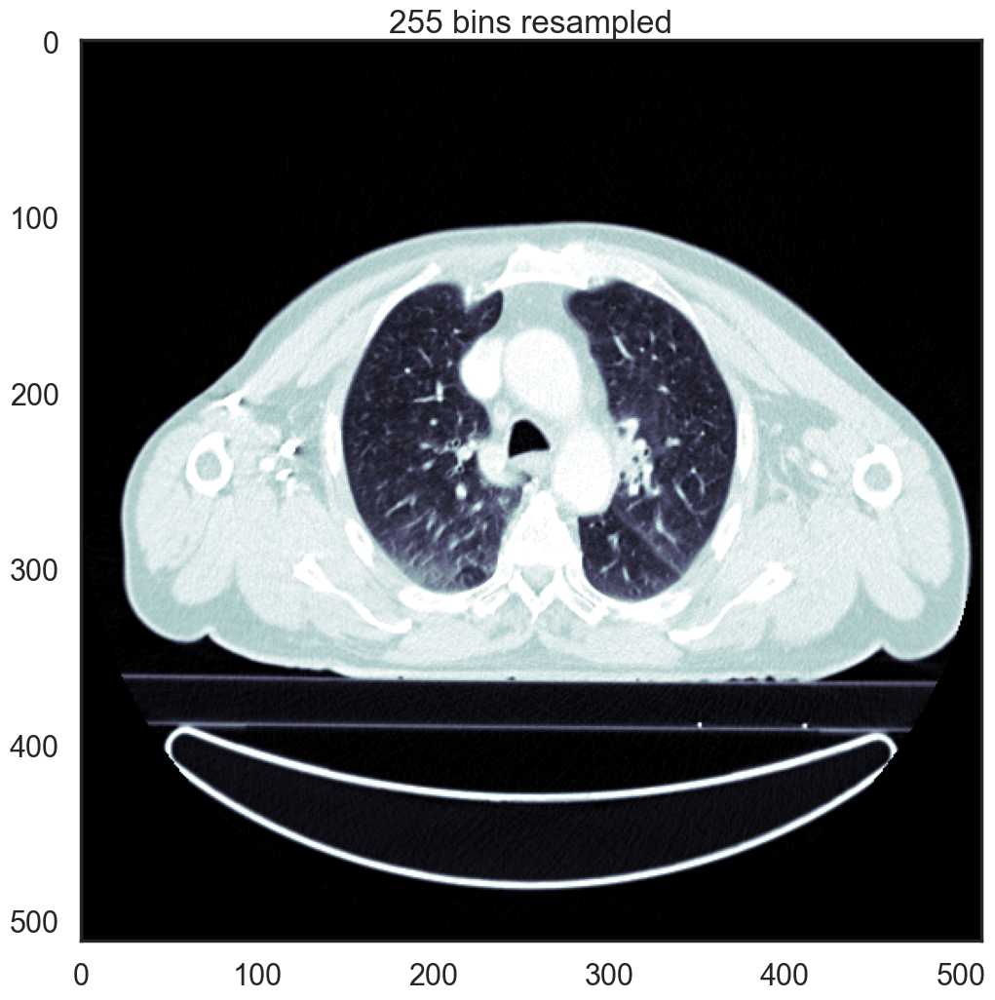

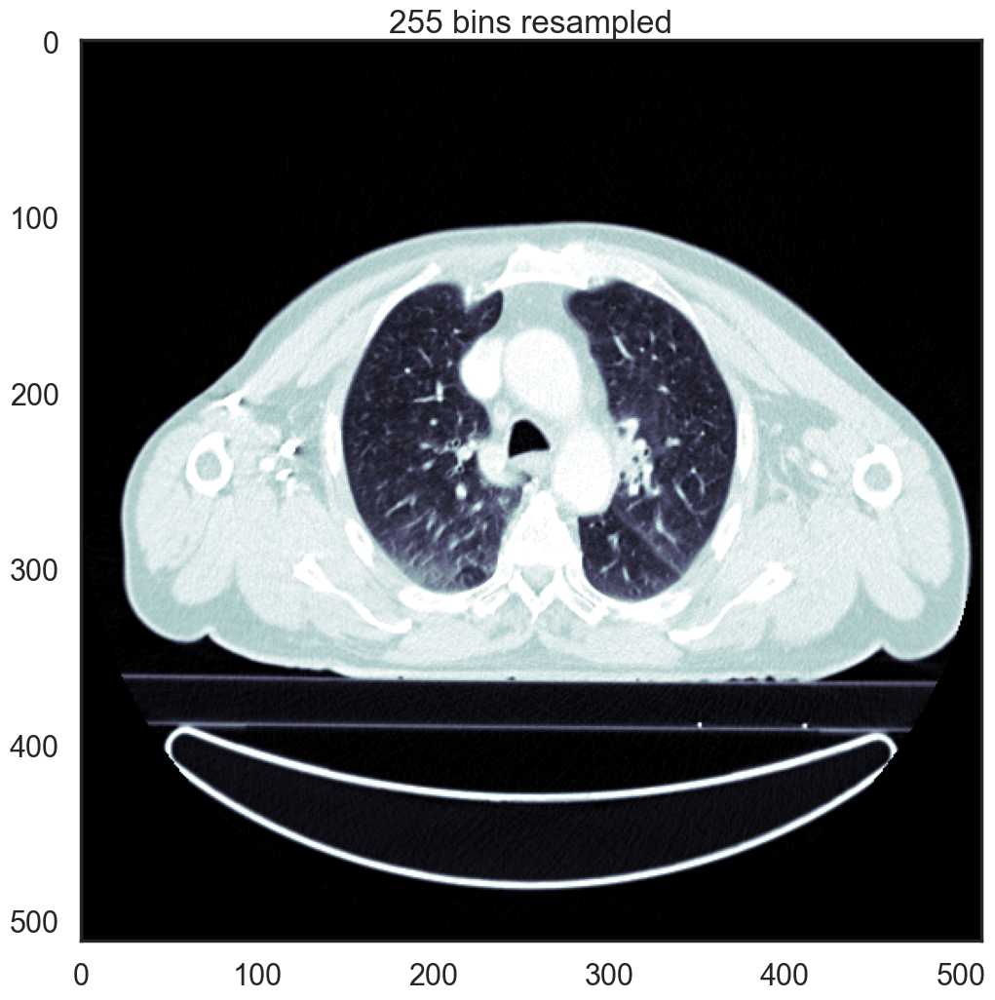

Z-score normalization applied based on the whole image, Mu=1000.0, sigma=500.0
Z-score normalization applied based on the whole image, Mu=1000.0, sigma=500.0


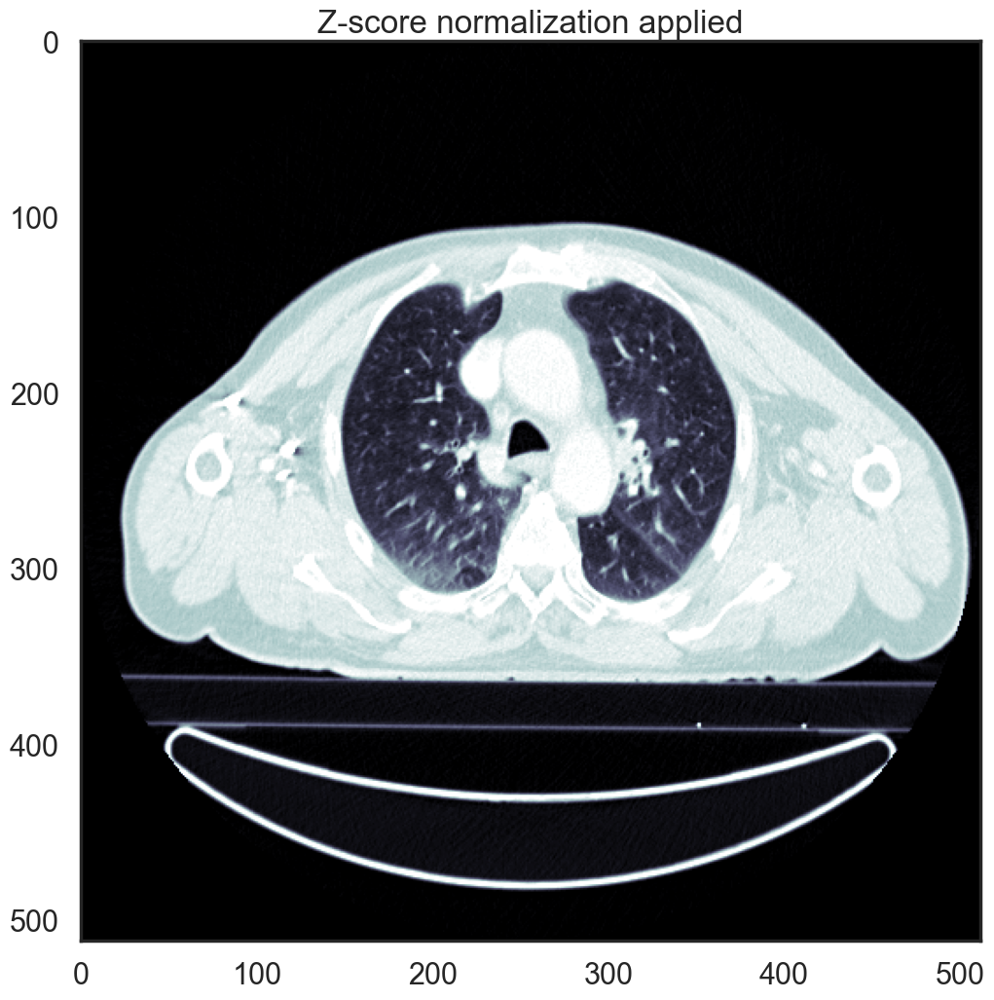

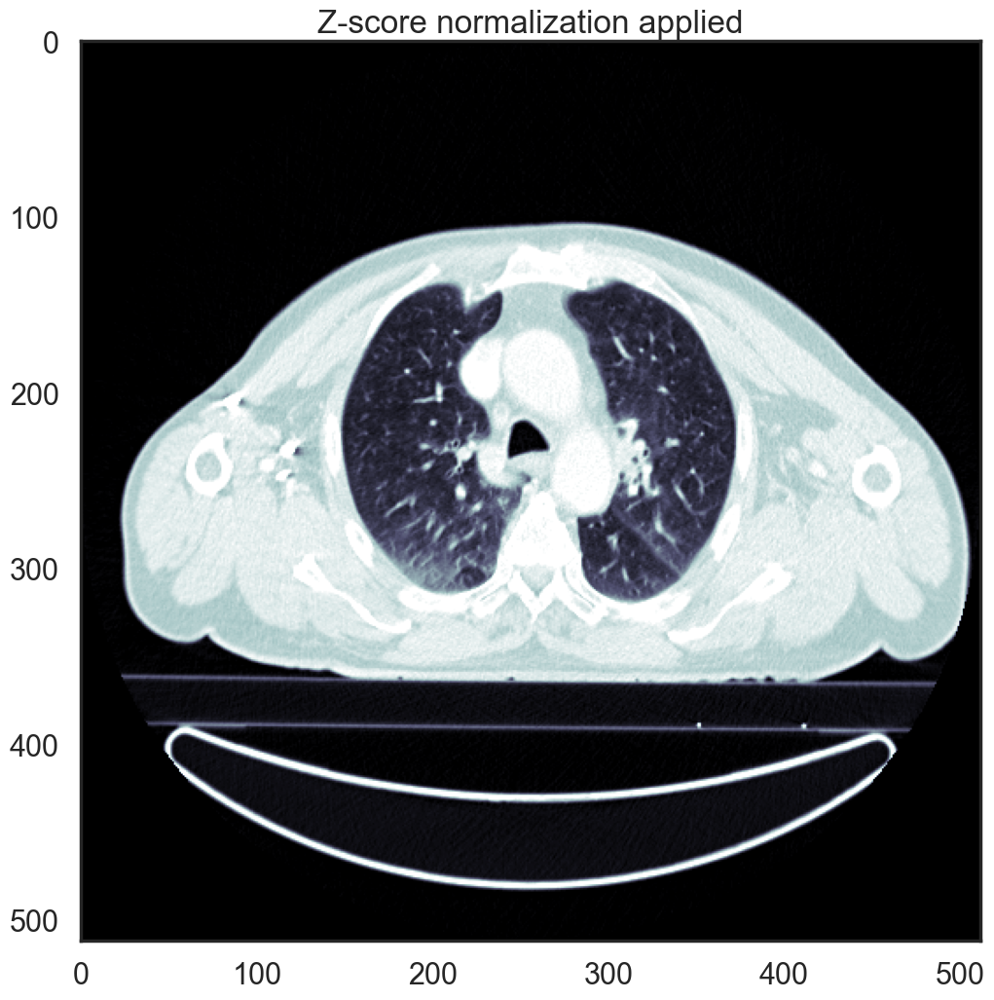

 60%|███████████████████████████                  | 3/5 [01:17<00:51, 25.72s/it]

----------------------------------------
Original image stats:
Number of unique intensity values : 3829
Intensity values range:[-1024:3071]
Image intensity dtype: int16
----------------------------------------
----------------------------------------
Original image stats:
Number of unique intensity values : 3829
Intensity values range:[-1024:3071]
Image intensity dtype: int16
----------------------------------------


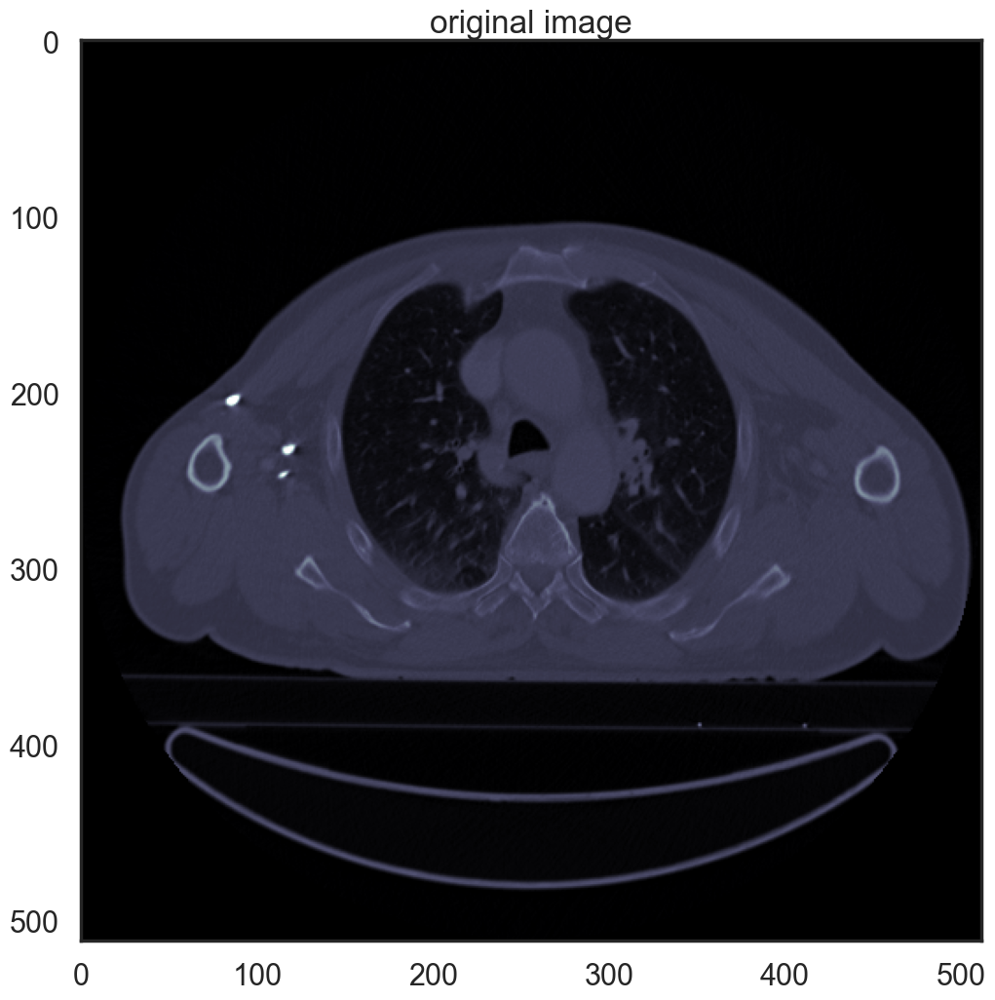

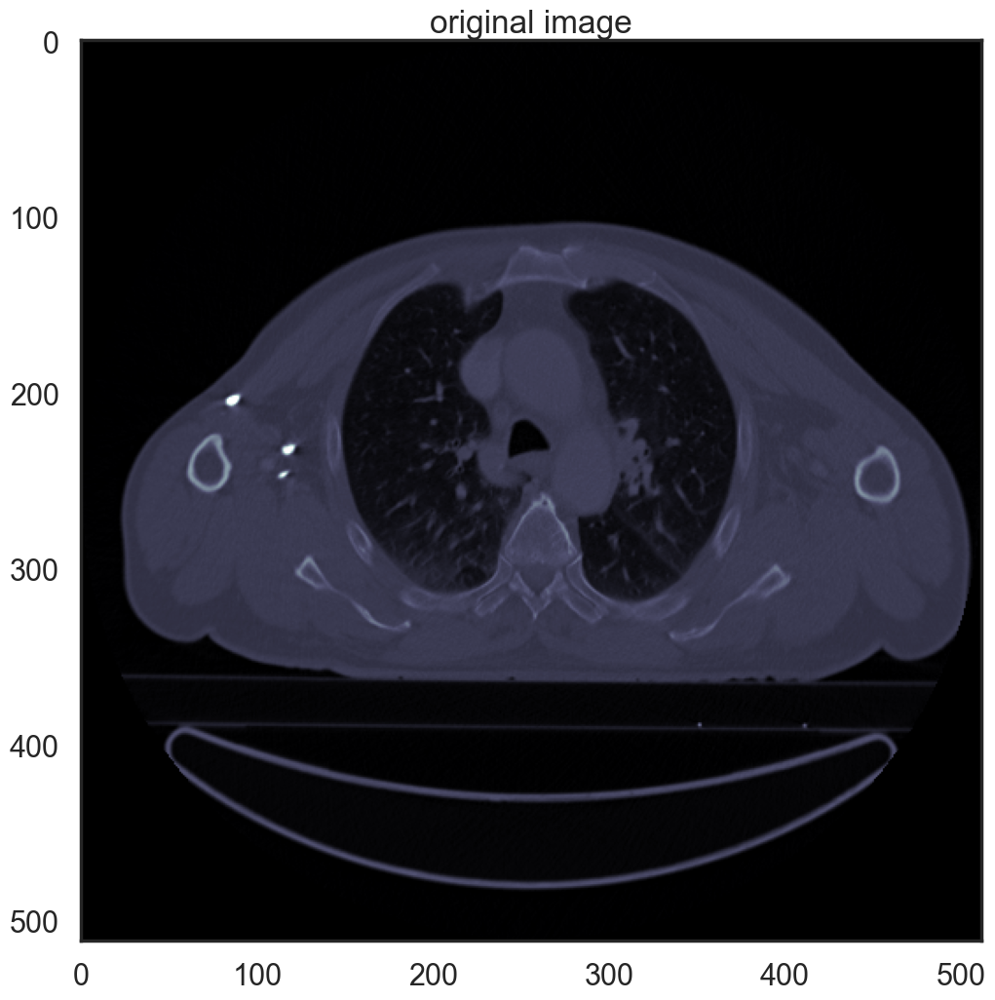

Window limits  -1000 150.0
Window limits  -1000 150.0
Window filtering applied
Window filtering applied


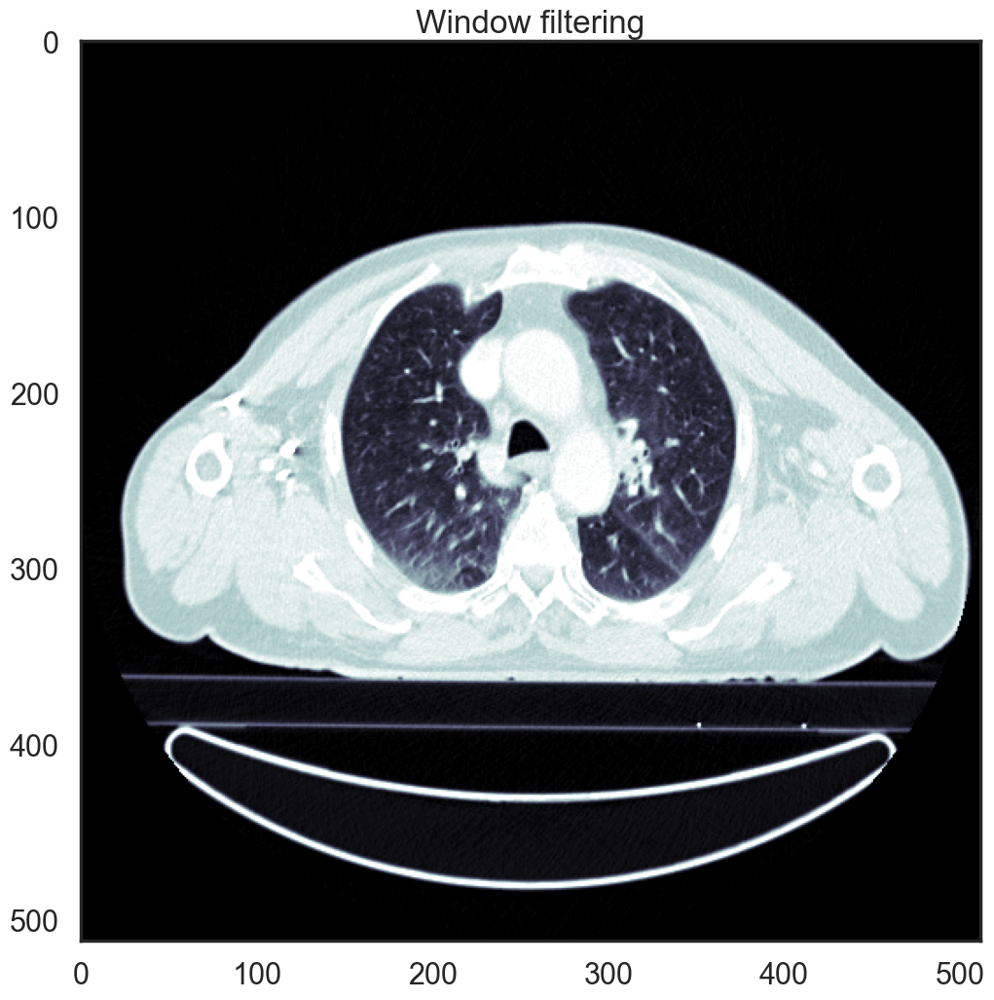

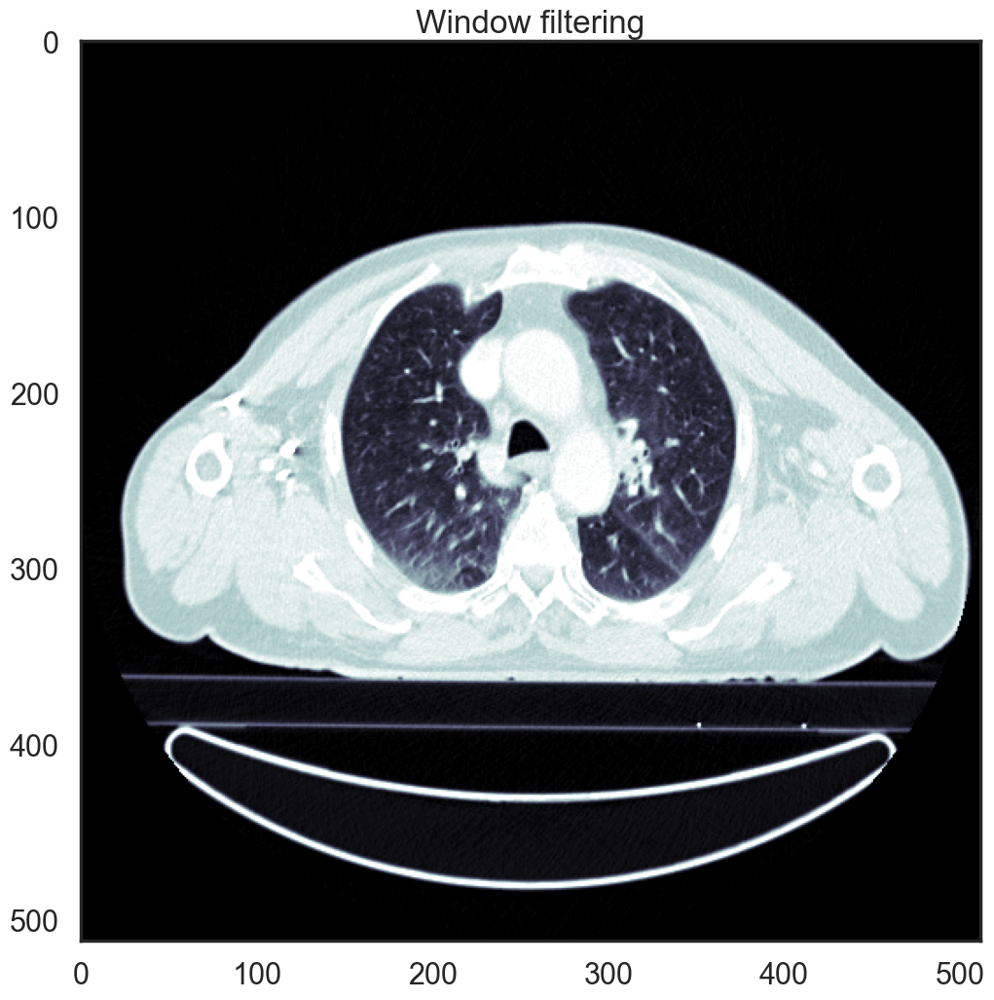

min:  0 max:  1150 step:  4.509803921568627
min:  0 max:  1150 step:  4.509803921568627
Resampling with a step of:  4.509803921568627 Amount of unique values, original img:  1151 resampled img:  255
Resampling with a step of:  4.509803921568627 Amount of unique values, original img:  1151 resampled img:  255
----------------------------------------
Intensity values resampled with a number of bins: 255
----------------------------------------
----------------------------------------
Intensity values resampled with a number of bins: 255
----------------------------------------


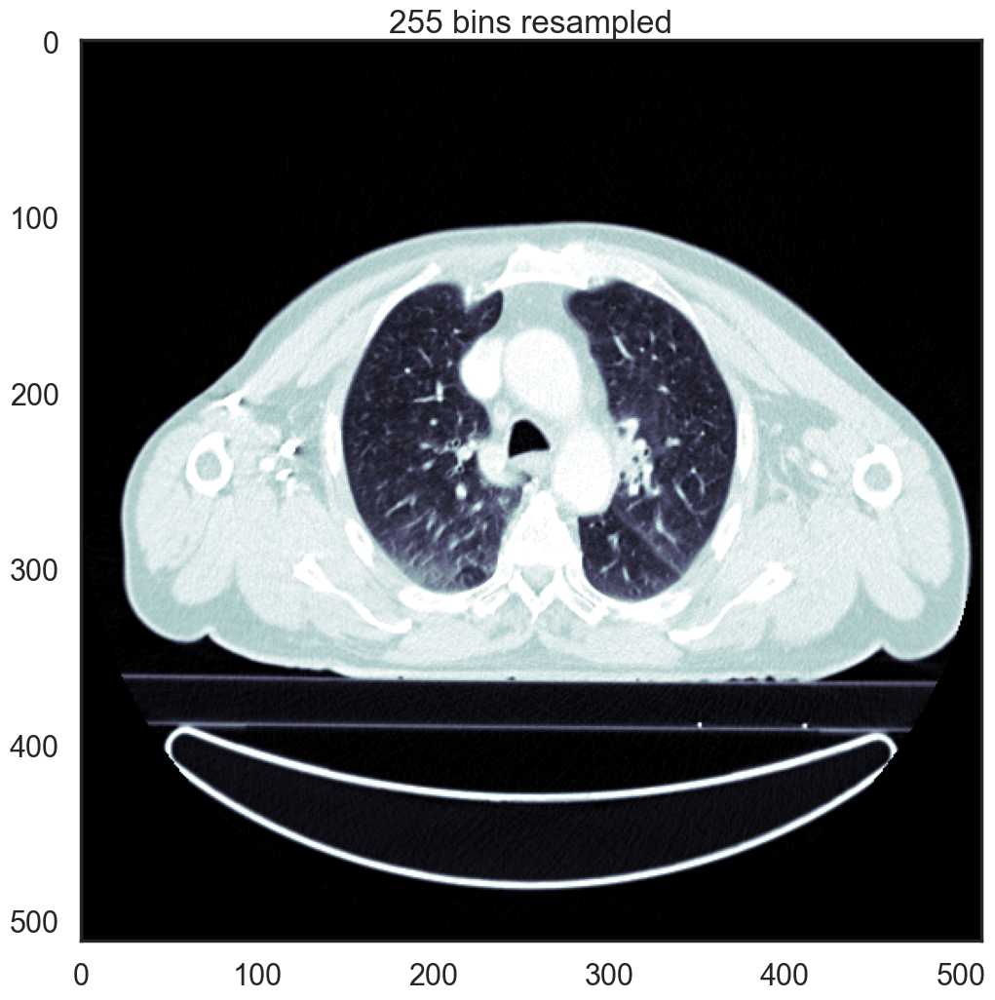

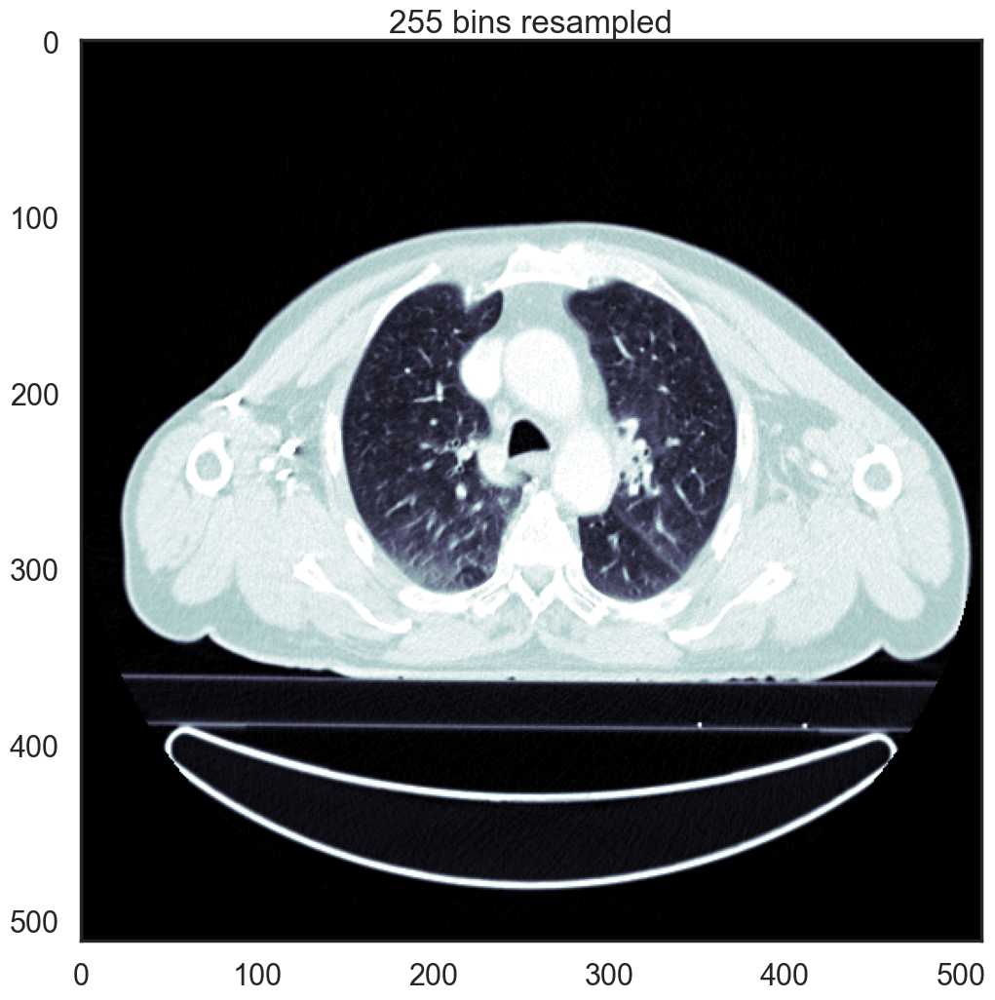

Z-score normalization applied based on the whole image, Mu=1000.0, sigma=500.0
Z-score normalization applied based on the whole image, Mu=1000.0, sigma=500.0


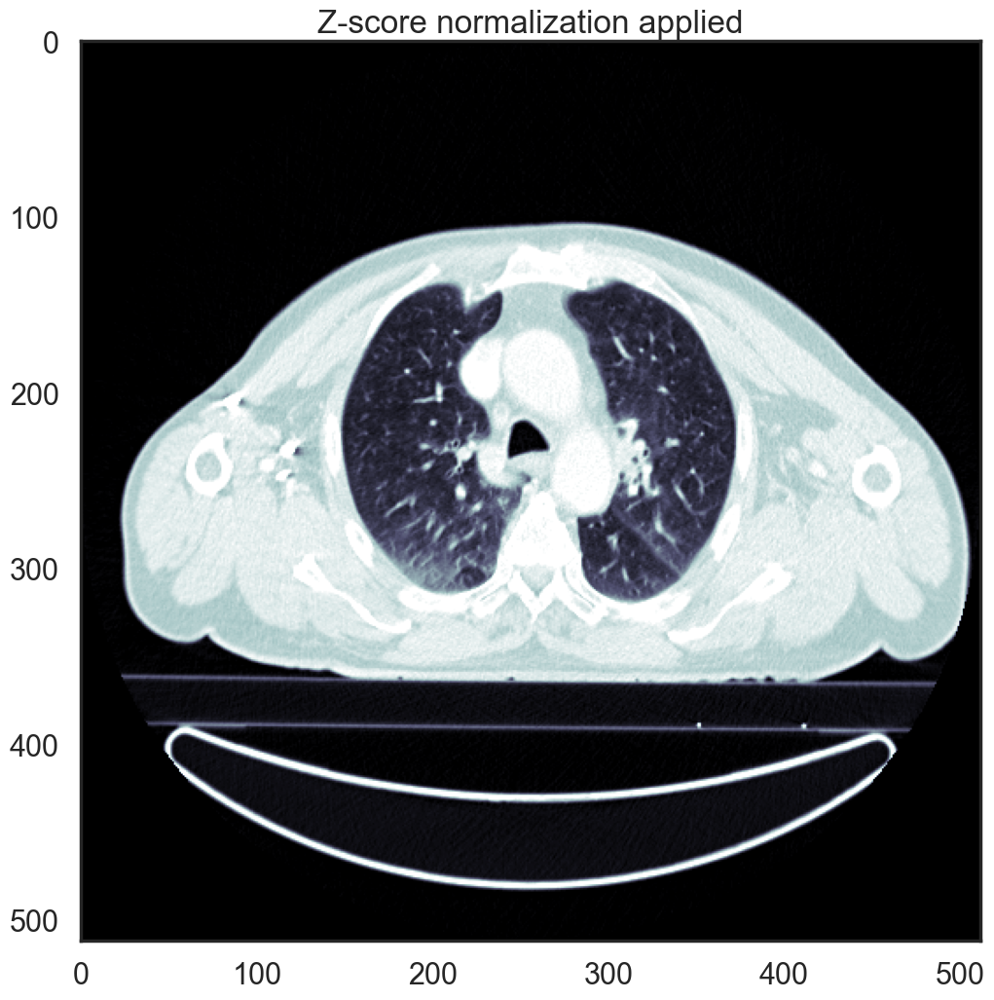

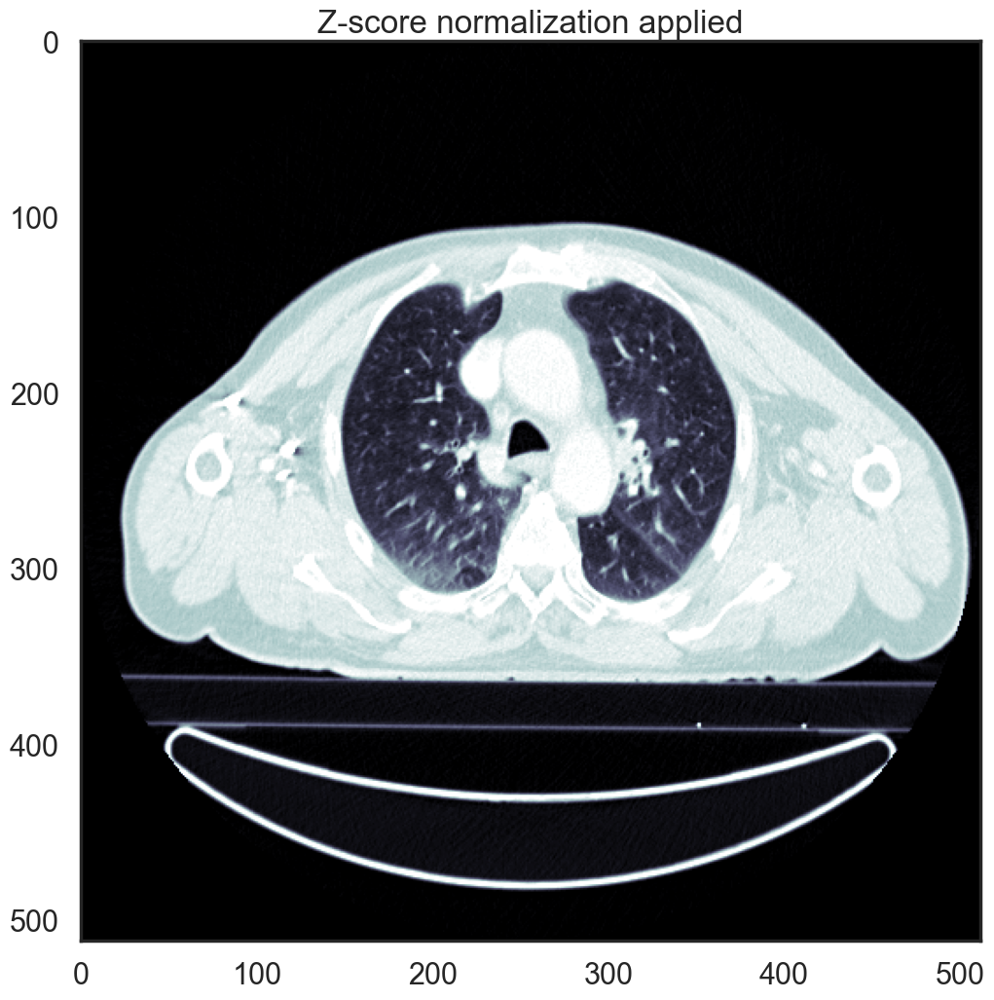

 80%|████████████████████████████████████         | 4/5 [01:41<00:25, 25.06s/it]

----------------------------------------
Original image stats:
Number of unique intensity values : 3829
Intensity values range:[-1024:3071]
Image intensity dtype: int16
----------------------------------------
----------------------------------------
Original image stats:
Number of unique intensity values : 3829
Intensity values range:[-1024:3071]
Image intensity dtype: int16
----------------------------------------


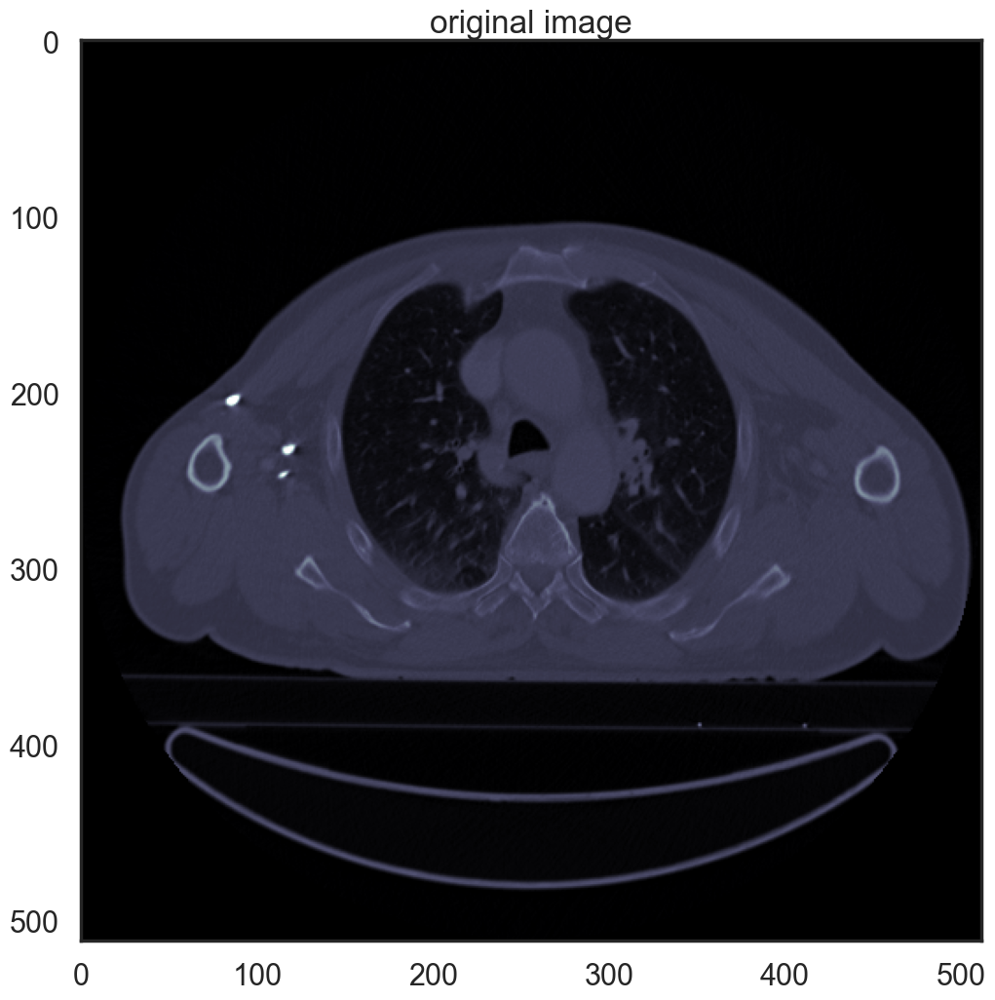

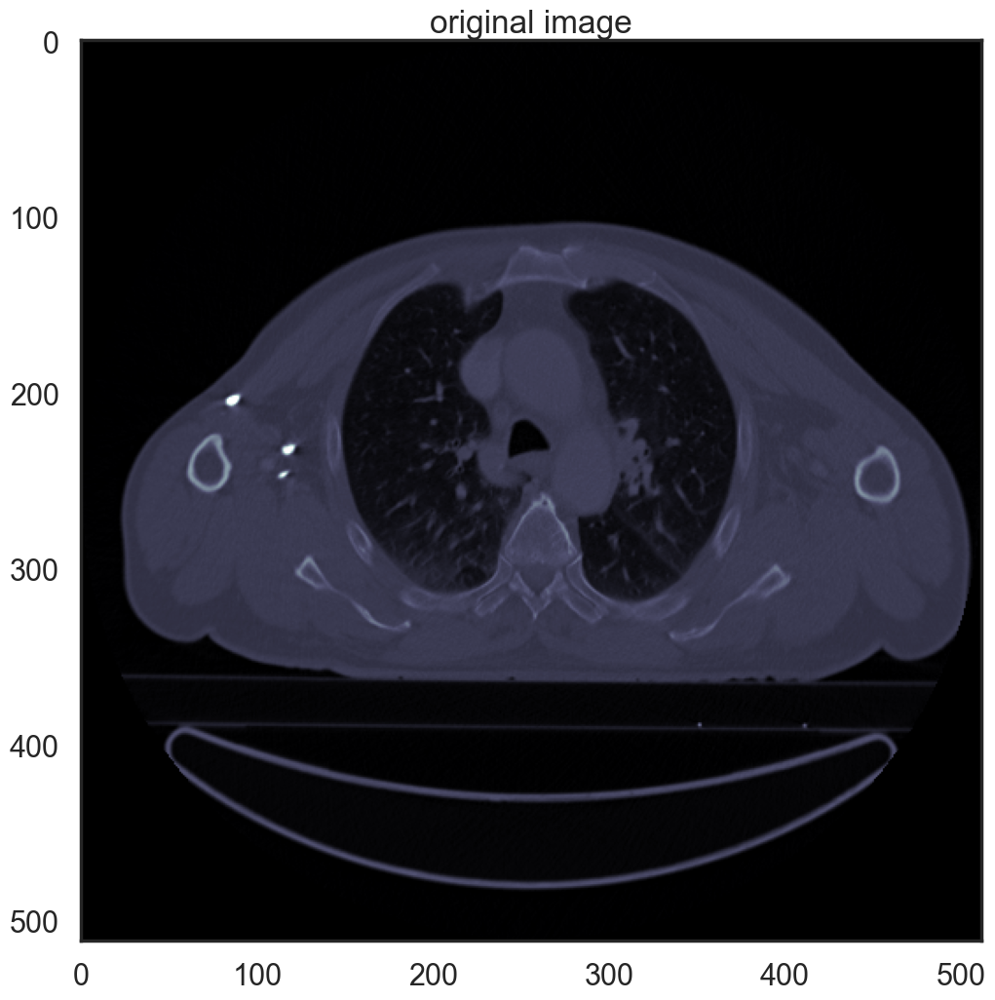

Window limits  -1000 150.0
Window limits  -1000 150.0
Window filtering applied
Window filtering applied


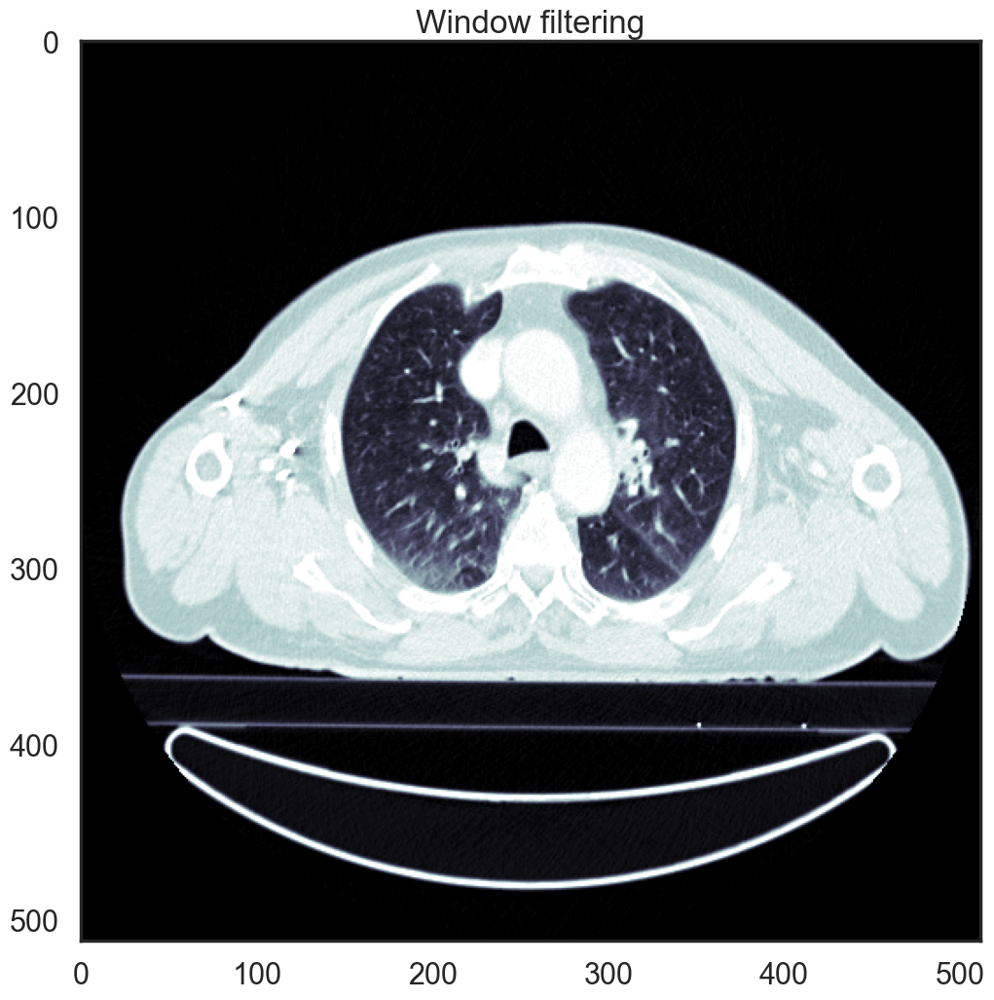

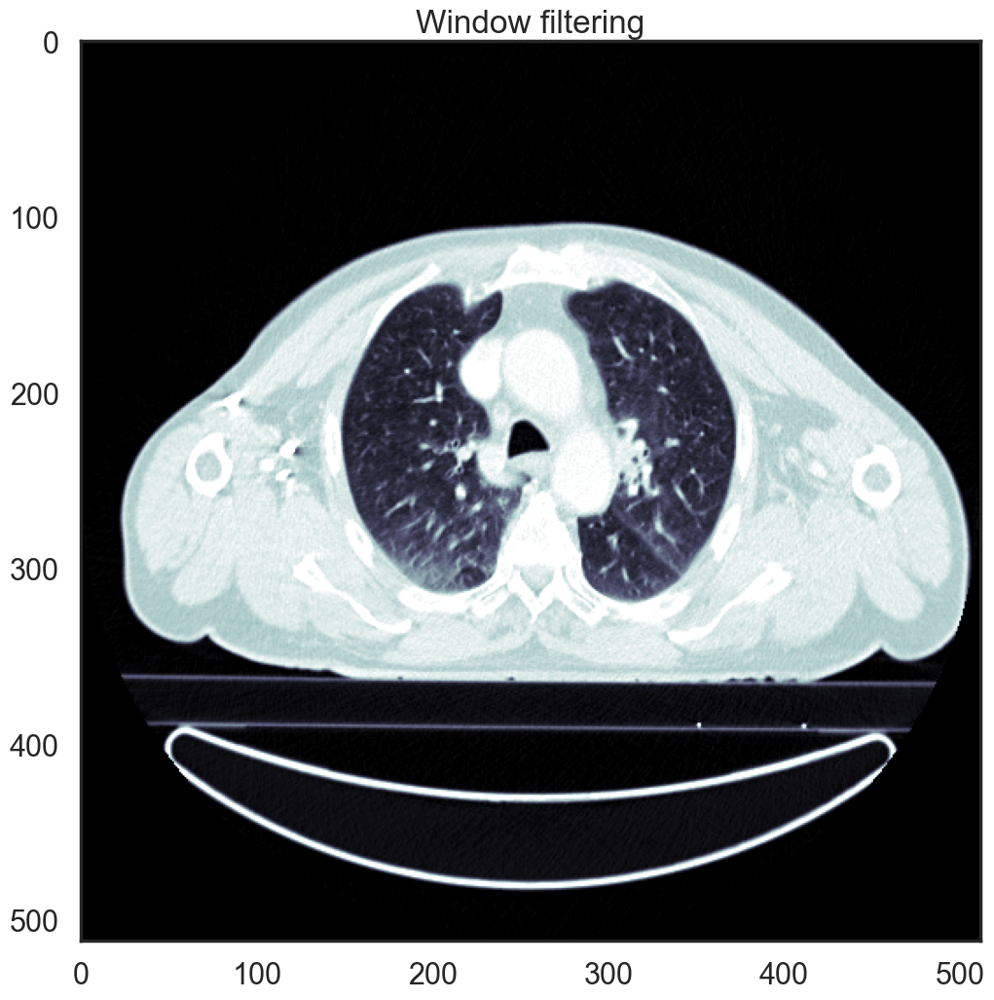

min:  0 max:  1150 step:  4.509803921568627
min:  0 max:  1150 step:  4.509803921568627
Resampling with a step of:  4.509803921568627 Amount of unique values, original img:  1151 resampled img:  255
Resampling with a step of:  4.509803921568627 Amount of unique values, original img:  1151 resampled img:  255
----------------------------------------
Intensity values resampled with a number of bins: 255
----------------------------------------
----------------------------------------
Intensity values resampled with a number of bins: 255
----------------------------------------


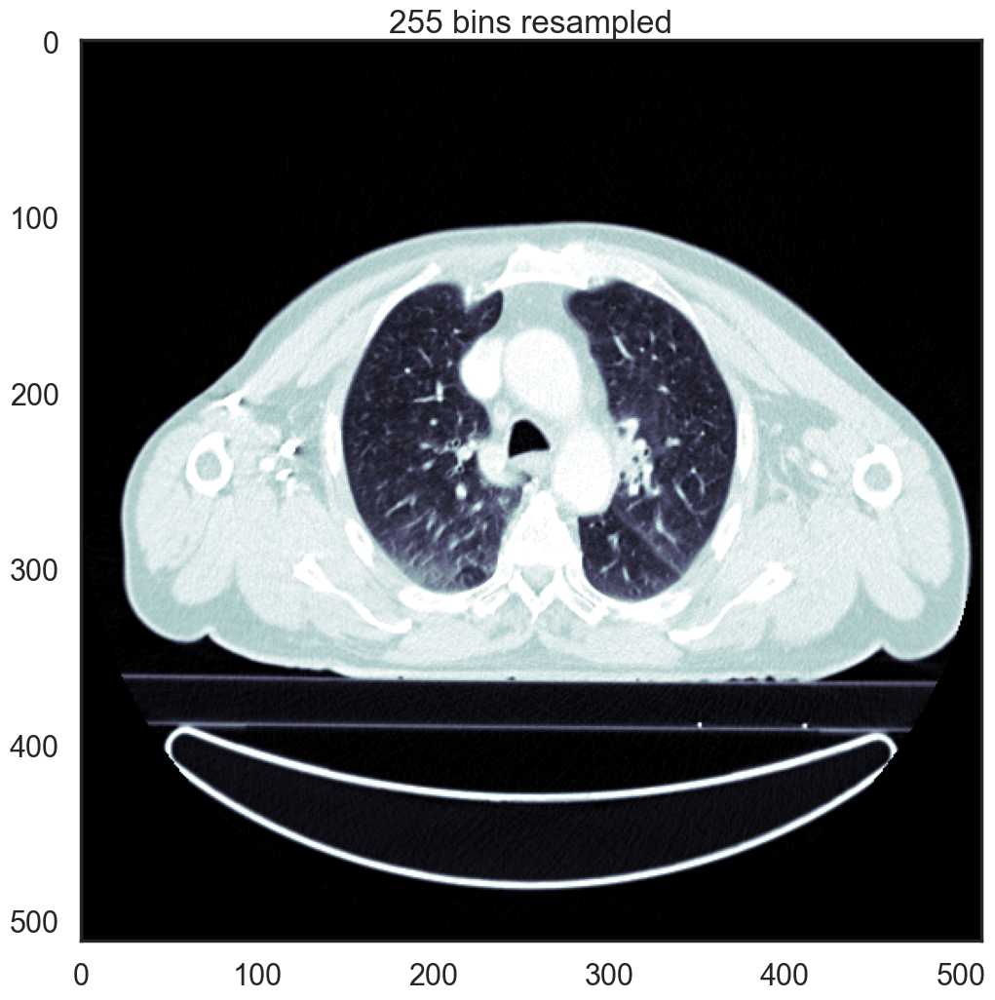

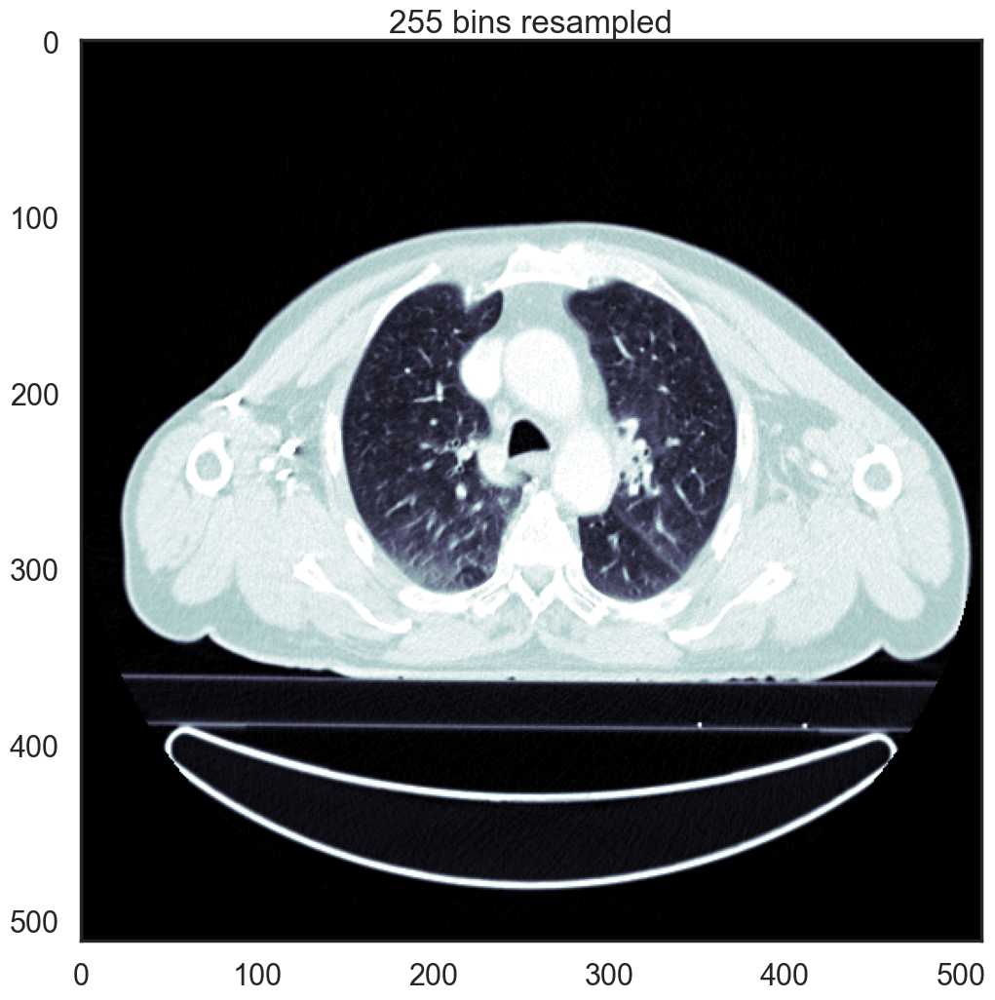

Z-score normalization applied based on the whole image, Mu=1000.0, sigma=500.0
Z-score normalization applied based on the whole image, Mu=1000.0, sigma=500.0


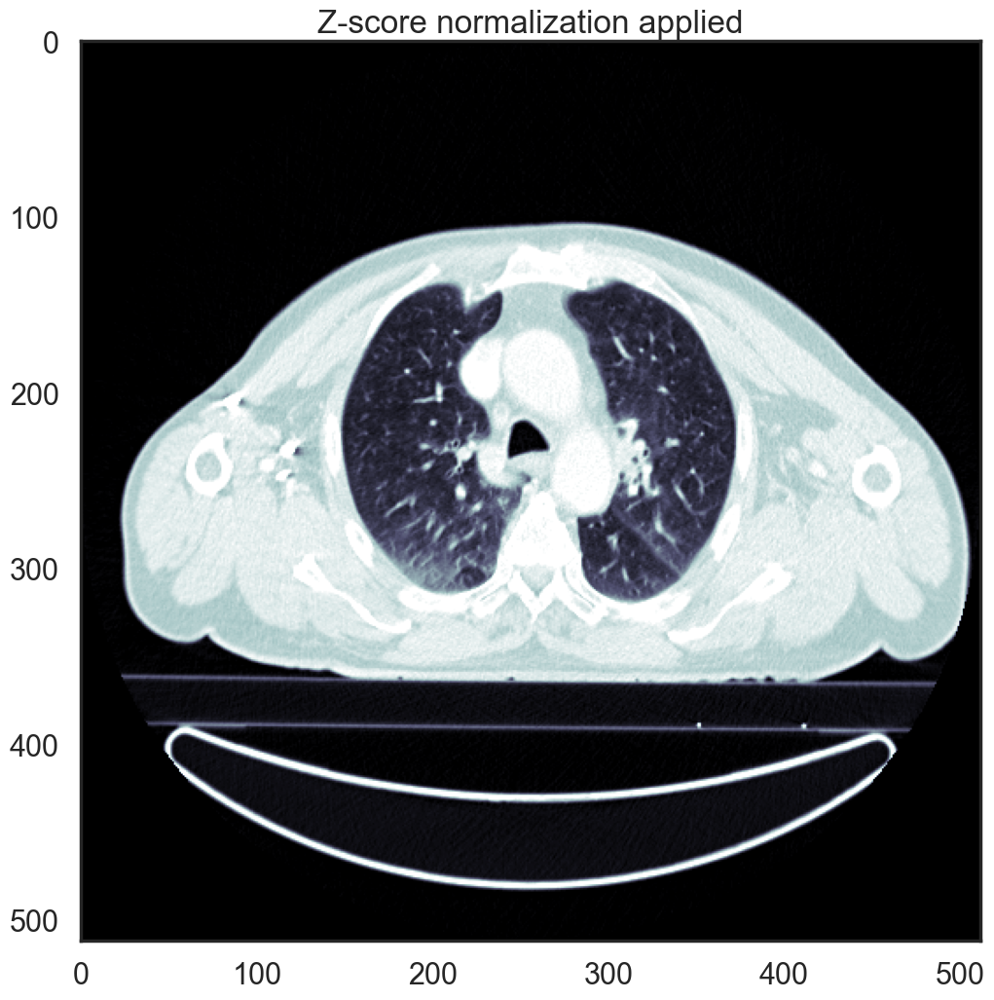

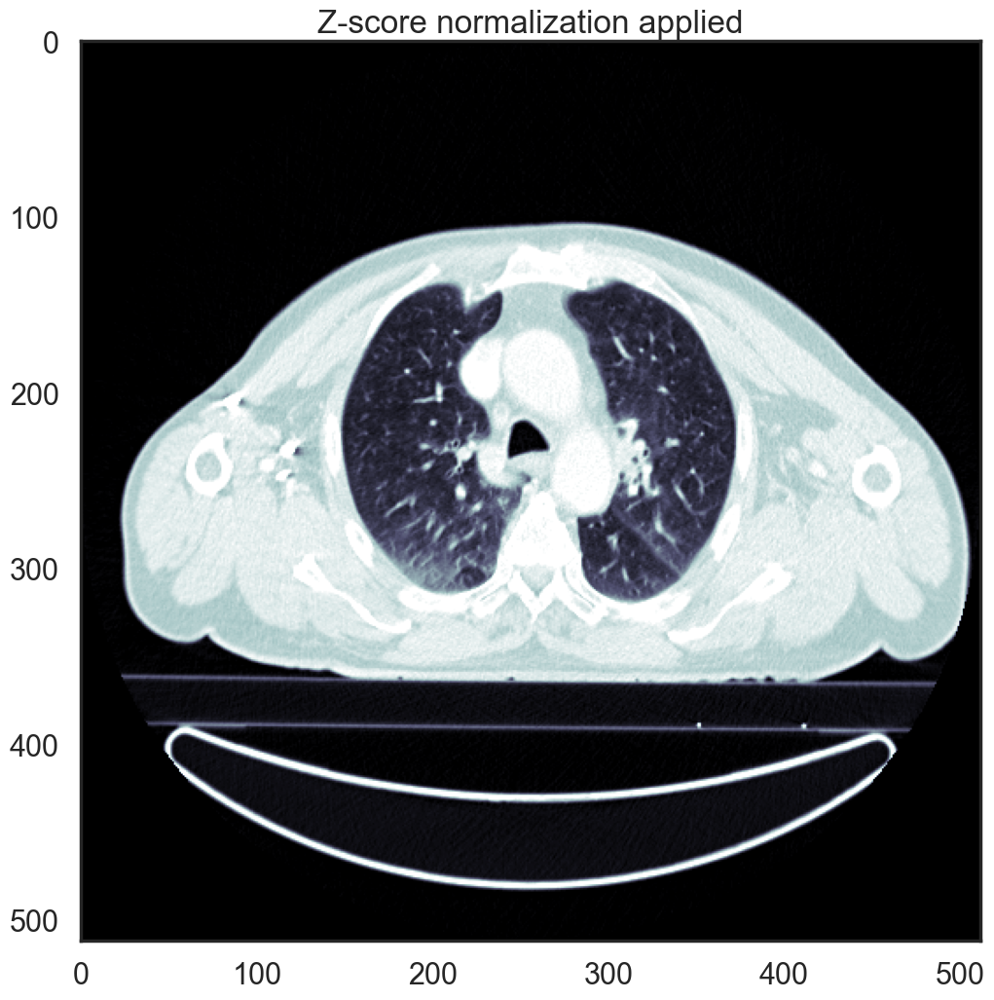

100%|█████████████████████████████████████████████| 5/5 [02:05<00:00, 25.04s/it]



In [20]:
sb.set(context='poster', style='white')
data_ct_nrrd.pre_process(ref_img_path = '../data/converted_nrrds/LUNG1-001_20180209_CT_2/image.nrrd',
                         save_path = '../data/nrrd_preprocessed',
                         hist_match = False,        # boolean
                         subcateneus_fat = False,   # boolean
                         fat_value = 774,           # this is a dummy value, 
                                                    # you would need to find that value for each image
                         percentile_scaling = False, # boolean
                         window_filtering_params = (1500,-600), #Window Filtering [WW,WL]
                         binning = 255,             # this is a dummy value, it takes False or int 
                                                    # (# of bins for intensity resampling)
                         verbosity = True,          # boolean
                         z_score = True,           # boolean 
                         hist_equalize = True,     # boolean
                         norm_coeff = (1000.,500.), # these are dummy values, you would need to estimate real mu and sigma
                                                    # it takes None or tuple: (mu,sigma)
                         visualize = True)

## PyRadiomics features extraction

In our toolbox, we are using PyRadiomics software (https://pyradiomics.readthedocs.io/en/latest/) to extract the features. You can read the full documentation for the currently stable version: https://pyradiomics.readthedocs.io/_/downloads/en/stable/pdf/.

We are using PyRadiomics parameters file customized for CT data:

In [21]:
parameters = r"example_ct_parameters.yaml"
features = data_ct_nrrd.extract_features(parameters, loggenabled=True)

2023-06-25 21:42:43,347:INFO:Loading parameter file example_ct_parameters.yaml
2023-06-25 21:42:43,347:INFO:Loading parameter file example_ct_parameters.yaml
2023-06-25 21:42:43,451:INFO:validation.valid
2023-06-25 21:42:43,451:INFO:validation.valid
2023-06-25 21:42:43,452:DEBUG:Parameters parsed, input is valid.
2023-06-25 21:42:43,452:DEBUG:Parameters parsed, input is valid.
2023-06-25 21:42:43,453:DEBUG:Applying settings
2023-06-25 21:42:43,453:DEBUG:Applying settings
2023-06-25 21:42:43,453:DEBUG:Enabled image types: {'Original': {}}
2023-06-25 21:42:43,453:DEBUG:Enabled image types: {'Original': {}}
2023-06-25 21:42:43,454:DEBUG:Enabled features: {'shape': None, 'firstorder': None, 'glrlm': None, 'glszm': None, 'gldm': None}
2023-06-25 21:42:43,454:DEBUG:Enabled features: {'shape': None, 'firstorder': None, 'glrlm': None, 'glszm': None, 'gldm': None}
2023-06-25 21:42:43,455:DEBUG:Settings: {'interpolator': 'sitkBSpline', 'resampledPixelSpacing': [1, 1, 1], 'padDistance': 10, 'binW

2023-06-25 21:42:52,615:DEBUG:First order feature class initialized
2023-06-25 21:42:52,615:DEBUG:First order feature class initialized
2023-06-25 21:42:52,616:DEBUG:Calculating features
2023-06-25 21:42:52,616:DEBUG:Calculating features
2023-06-25 21:42:52,712:INFO:Computing glrlm
2023-06-25 21:42:52,712:INFO:Computing glrlm
2023-06-25 21:42:52,713:DEBUG:Initializing feature class
2023-06-25 21:42:52,713:DEBUG:Initializing feature class
2023-06-25 21:42:52,715:DEBUG:Discretizing gray levels inside ROI
2023-06-25 21:42:52,715:DEBUG:Discretizing gray levels inside ROI
2023-06-25 21:42:52,753:DEBUG:Calculated 70 bins for bin width 25 with edges: [-1050 -1025 -1000  -975  -950  -925  -900  -875  -850  -825  -800  -775
  -750  -725  -700  -675  -650  -625  -600  -575  -550  -525  -500  -475
  -450  -425  -400  -375  -350  -325  -300  -275  -250  -225  -200  -175
  -150  -125  -100   -75   -50   -25     0    25    50    75   100   125
   150   175   200   225   250   275   300   325   350  

2023-06-25 21:42:55,749:DEBUG:Checking ROI validity
2023-06-25 21:42:55,749:DEBUG:Checking ROI validity
2023-06-25 21:42:55,773:DEBUG:Checking if label 1 is persent in the mask
2023-06-25 21:42:55,775:DEBUG:Comparing physical space of bounding box to physical space of image
2023-06-25 21:42:55,776:DEBUG:ROI bounds (image coordinate space): ((289.5, 225.5, 64.5), (386.5, 315.5, 85.5))
2023-06-25 21:42:55,773:DEBUG:Checking if label 1 is persent in the mask
2023-06-25 21:42:55,775:DEBUG:Comparing physical space of bounding box to physical space of image
2023-06-25 21:42:55,776:DEBUG:ROI bounds (image coordinate space): ((289.5, 225.5, 64.5), (386.5, 315.5, 85.5))
2023-06-25 21:42:55,779:DEBUG:ROI valid, calculating resampling grid
2023-06-25 21:42:55,780:DEBUG:Comparing resampled spacing to original spacing (image
2023-06-25 21:42:55,779:DEBUG:ROI valid, calculating resampling grid
2023-06-25 21:42:55,780:DEBUG:Comparing resampled spacing to original spacing (image
2023-06-25 21:42:55,78

2023-06-25 21:42:59,402:DEBUG:Calculated 90 bins for bin width 25 with edges: [-1125 -1100 -1075 -1050 -1025 -1000  -975  -950  -925  -900  -875  -850
  -825  -800  -775  -750  -725  -700  -675  -650  -625  -600  -575  -550
  -525  -500  -475  -450  -425  -400  -375  -350  -325  -300  -275  -250
  -225  -200  -175  -150  -125  -100   -75   -50   -25     0    25    50
    75   100   125   150   175   200   225   250   275   300   325   350
   375   400   425   450   475   500   525   550   575   600   625   650
   675   700   725   750   775   800   825   850   875   900   925   950
   975  1000  1025  1050  1075  1100  1125])
2023-06-25 21:42:59,412:DEBUG:Calculating GLSZM matrix in C
2023-06-25 21:42:59,412:DEBUG:Calculating GLSZM matrix in C
2023-06-25 21:42:59,497:DEBUG:Calculating GLSZM coefficients
2023-06-25 21:42:59,497:DEBUG:Calculating GLSZM coefficients
2023-06-25 21:42:59,507:DEBUG:GLSZM feature class initialized, calculated GLSZM with shape (1, 85, 98)
2023-06-25 21:42:59,5

2023-06-25 21:43:03,180:DEBUG:Creating image type iterator
2023-06-25 21:43:03,180:DEBUG:Creating image type iterator
2023-06-25 21:43:03,181:INFO:Adding image type "Original" with custom settings: {}
2023-06-25 21:43:03,181:INFO:Adding image type "Original" with custom settings: {}
2023-06-25 21:43:03,181:DEBUG:Extracting features
2023-06-25 21:43:03,181:DEBUG:Extracting features
2023-06-25 21:43:03,182:DEBUG:Yielding original image
2023-06-25 21:43:03,182:INFO:Calculating features for original image
2023-06-25 21:43:03,182:DEBUG:Yielding original image
2023-06-25 21:43:03,182:INFO:Calculating features for original image
2023-06-25 21:43:03,184:DEBUG:Cropping to size [44 71 51]
2023-06-25 21:43:03,184:DEBUG:Cropping to size [44 71 51]
2023-06-25 21:43:03,187:INFO:Computing firstorder
2023-06-25 21:43:03,187:INFO:Computing firstorder
2023-06-25 21:43:03,189:DEBUG:Initializing feature class
2023-06-25 21:43:03,189:DEBUG:Initializing feature class
2023-06-25 21:43:03,191:DEBUG:Discretizi

2023-06-25 21:43:03,456:INFO:Loading image and mask
2023-06-25 21:43:03,456:DEBUG:Force casting mask to UInt32 to ensure correct datatype.
2023-06-25 21:43:03,456:DEBUG:Force casting mask to UInt32 to ensure correct datatype.
2023-06-25 21:43:05,083:DEBUG:Resampling image and mask
2023-06-25 21:43:05,083:DEBUG:Resampling image and mask
2023-06-25 21:43:05,085:DEBUG:Where resampled spacing is set to 0, set it to the original spacing (mask)
2023-06-25 21:43:05,085:DEBUG:Where resampled spacing is set to 0, set it to the original spacing (mask)
2023-06-25 21:43:05,085:DEBUG:Checking ROI validity
2023-06-25 21:43:05,085:DEBUG:Checking ROI validity
2023-06-25 21:43:05,101:DEBUG:Checking if label 1 is persent in the mask
2023-06-25 21:43:05,101:DEBUG:Checking if label 1 is persent in the mask
2023-06-25 21:43:05,102:DEBUG:Comparing physical space of bounding box to physical space of image
2023-06-25 21:43:05,102:DEBUG:Comparing physical space of bounding box to physical space of image
2023-0

2023-06-25 21:43:06,762:DEBUG:Calculating GLSZM matrix in C
2023-06-25 21:43:06,762:DEBUG:Calculating GLSZM matrix in C
2023-06-25 21:43:06,768:DEBUG:Calculating GLSZM coefficients
2023-06-25 21:43:06,768:DEBUG:Calculating GLSZM coefficients
2023-06-25 21:43:06,770:DEBUG:GLSZM feature class initialized, calculated GLSZM with shape (1, 39, 48)
2023-06-25 21:43:06,770:DEBUG:Calculating features
2023-06-25 21:43:06,772:INFO:Computing gldm
2023-06-25 21:43:06,770:DEBUG:GLSZM feature class initialized, calculated GLSZM with shape (1, 39, 48)
2023-06-25 21:43:06,770:DEBUG:Calculating features
2023-06-25 21:43:06,772:INFO:Computing gldm
2023-06-25 21:43:06,773:DEBUG:Initializing feature class
2023-06-25 21:43:06,773:DEBUG:Initializing feature class
2023-06-25 21:43:06,774:DEBUG:Discretizing gray levels inside ROI
2023-06-25 21:43:06,774:DEBUG:Discretizing gray levels inside ROI
2023-06-25 21:43:06,776:DEBUG:Calculated 51 bins for bin width 25 with edges: [-1000  -975  -950  -925  -900  -875  

2023-06-25 21:43:10,278:DEBUG:Calculated 79 bins for bin width 25 with edges: [-350 -325 -300 -275 -250 -225 -200 -175 -150 -125 -100  -75  -50  -25
    0   25   50   75  100  125  150  175  200  225  250  275  300  325
  350  375  400  425  450  475  500  525  550  575  600  625  650  675
  700  725  750  775  800  825  850  875  900  925  950  975 1000 1025
 1050 1075 1100 1125 1150 1175 1200 1225 1250 1275 1300 1325 1350 1375
 1400 1425 1450 1475 1500 1525 1550 1575 1600 1625])
2023-06-25 21:43:10,283:DEBUG:First order feature class initialized
2023-06-25 21:43:10,283:DEBUG:Calculating features
2023-06-25 21:43:10,278:DEBUG:Calculated 79 bins for bin width 25 with edges: [-350 -325 -300 -275 -250 -225 -200 -175 -150 -125 -100  -75  -50  -25
    0   25   50   75  100  125  150  175  200  225  250  275  300  325
  350  375  400  425  450  475  500  525  550  575  600  625  650  675
  700  725  750  775  800  825  850  875  900  925  950  975 1000 1025
 1050 1075 1100 1125 1150 1175 12

Printing the features for first 3 ROIs:

In [22]:
features.head(3)

,diagnostics_Versions_PyRadiomics,diagnostics_Versions_Numpy,diagnostics_Versions_SimpleITK,diagnostics_Versions_PyWavelet,diagnostics_Versions_Python,diagnostics_Configuration_Settings,diagnostics_Configuration_EnabledImageTypes,diagnostics_Image-original_Hash,diagnostics_Image-original_Dimensionality,diagnostics_Image-original_Spacing,...,original_gldm_HighGrayLevelEmphasis,original_gldm_LargeDependenceEmphasis,original_gldm_LargeDependenceHighGrayLevelEmphasis,original_gldm_LargeDependenceLowGrayLevelEmphasis,original_gldm_LowGrayLevelEmphasis,original_gldm_SmallDependenceEmphasis,original_gldm_SmallDependenceHighGrayLevelEmphasis,original_gldm_SmallDependenceLowGrayLevelEmphasis,Patient,ROI
0,v3.0.1,1.21.6,2.2.1,1.3.0,3.7.16,"{'minimumROIDimensions': 2, 'minimumROISize': ...",{'Original': {}},5c66c70353901fd238191b88a2584cd8c3f645e5,3D,"(0.977, 0.977, 3.0)",...,1731.2372665333567,124.54216692742976,243373.09511578162,0.07974467815992821,0.0011213314231000426,0.0911157206194848,106.00051605739702,0.00017046775986821598,LUNG1-002_20180526_CT_1_GTV-1_mask,GTV-1_mask
1,v3.0.1,1.21.6,2.2.1,1.3.0,3.7.16,"{'minimumROIDimensions': 2, 'minimumROISize': ...",{'Original': {}},01ae3d400f3f6fdacc121a85f52fd9dba8be2253,3D,"(0.9765625, 0.9765625, 3.0)",...,1907.8928027161019,99.42648713645454,213058.91888989627,0.059357098967502825,0.0008981270271727171,0.13258230653722738,173.11811535919472,0.0001963430889220179,LUNG1-001_20180209_CT_2_GTV-1_mask,GTV-1_mask
2,v3.0.1,1.21.6,2.2.1,1.3.0,3.7.16,"{'minimumROIDimensions': 2, 'minimumROISize': ...",{'Original': {}},9a2b123cabcc00593e4255d41cbef78f0cb63630,3D,"(0.977, 0.977, 3.0)",...,1345.2481601916822,43.41137543499344,73313.80090136346,0.03577036805084389,0.0014948226269770068,0.21503292892228046,208.86350855024853,0.00045163939418009307,LUNG1-003_20180209_CT_1_GTV-1_mask,GTV-1_mask


,diagnostics_Versions_PyRadiomics,diagnostics_Versions_Numpy,diagnostics_Versions_SimpleITK,diagnostics_Versions_PyWavelet,diagnostics_Versions_Python,diagnostics_Configuration_Settings,diagnostics_Configuration_EnabledImageTypes,diagnostics_Image-original_Hash,diagnostics_Image-original_Dimensionality,diagnostics_Image-original_Spacing,...,original_gldm_HighGrayLevelEmphasis,original_gldm_LargeDependenceEmphasis,original_gldm_LargeDependenceHighGrayLevelEmphasis,original_gldm_LargeDependenceLowGrayLevelEmphasis,original_gldm_LowGrayLevelEmphasis,original_gldm_SmallDependenceEmphasis,original_gldm_SmallDependenceHighGrayLevelEmphasis,original_gldm_SmallDependenceLowGrayLevelEmphasis,Patient,ROI
0,v3.0.1,1.21.6,2.2.1,1.3.0,3.7.16,"{'minimumROIDimensions': 2, 'minimumROISize': ...",{'Original': {}},5c66c70353901fd238191b88a2584cd8c3f645e5,3D,"(0.977, 0.977, 3.0)",...,1731.2372665333567,124.54216692742976,243373.09511578162,0.07974467815992821,0.0011213314231000426,0.0911157206194848,106.00051605739702,0.00017046775986821598,LUNG1-002_20180526_CT_1_GTV-1_mask,GTV-1_mask
1,v3.0.1,1.21.6,2.2.1,1.3.0,3.7.16,"{'minimumROIDimensions': 2, 'minimumROISize': ...",{'Original': {}},01ae3d400f3f6fdacc121a85f52fd9dba8be2253,3D,"(0.9765625, 0.9765625, 3.0)",...,1907.8928027161019,99.42648713645454,213058.91888989627,0.059357098967502825,0.0008981270271727171,0.13258230653722738,173.11811535919472,0.0001963430889220179,LUNG1-001_20180209_CT_2_GTV-1_mask,GTV-1_mask
2,v3.0.1,1.21.6,2.2.1,1.3.0,3.7.16,"{'minimumROIDimensions': 2, 'minimumROISize': ...",{'Original': {}},9a2b123cabcc00593e4255d41cbef78f0cb63630,3D,"(0.977, 0.977, 3.0)",...,1345.2481601916822,43.41137543499344,73313.80090136346,0.03577036805084389,0.0014948226269770068,0.21503292892228046,208.86350855024853,0.00045163939418009307,LUNG1-003_20180209_CT_1_GTV-1_mask,GTV-1_mask


Writing the features into the Excel file (you will find it in the 'data/features' folder):

In [23]:
writer = pd.ExcelWriter('../data/features/extracted_features.xlsx') 
features.to_excel(writer, 'Sheet1')
writer.save()